In [1]:
from IPython.display import display, HTML
display(HTML("<style>.container {width: 95% !important; }</style>"))

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">IMPORTING LIBRARIES</p>

First I imported the libraries needed for data analytics.

In [110]:
import numpy as np
import pandas as pd
import datetime
import matplotlib
import matplotlib.pyplot as plt
from matplotlib import colors
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from yellowbrick.cluster import KElbowVisualizer
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt, numpy as np
from mpl_toolkits.mplot3d import Axes3D
from sklearn.cluster import AgglomerativeClustering
from matplotlib.colors import ListedColormap
from sklearn import metrics
import warnings
import sys
if not sys.warnoptions:
    warnings.simplefilter("ignore")
np.random.seed(42)

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">LOADING DATASET</p>

In [83]:
data = pd.read_csv('C:/Users/Ivan/Desktop/my_First_Python_Project/data/raw/autoscout24.from_base.csv')
print("Number of datapoints:", len(data))
pd.set_option('display.max_rows', None)
data

Number of datapoints: 3166


,Model,Mileage (km),Gearbox,First registration,Fuel type,Power (kW),Price,Country code,Years since first registration
0,Volvo P1800,123500,Manual,1963-07-01,Gasoline,66,54900,DE,60
1,Volvo C40,6,Automatic,2022-08-01,Electric,300,48800,ES,1
2,Volvo XC60,1,Automatic,2019-04-01,Gasoline,184,36500,ES,4
3,Volvo C40,1990,Automatic,2022-04-01,Electric,300,51600,ES,1
4,Volvo C40,8915,Automatic,2022-03-01,Electric,300,61990,BE,1
5,Volvo S60,147300,Automatic,2010-07-01,Gasoline,243,19980,DE,13
6,Volvo C30,208600,Manual,2007-01-01,Gasoline,125,5980,DE,16
7,Volvo C40,3500,Automatic,2022-11-01,Electric,300,59990,DE,1
8,Volvo XC60,127000,Automatic,2018-07-01,Electric/Gasoline,300,29990,ES,5
9,Volvo XC60,150000,Automatic,2016-09-01,Diesel,140,18985,DE,7


<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">EXPLORING AND UNDERSTANDING THE DATASET</p>

At the beginning, after importing the data I tried to explore and understand the data to get meaningful insights.

In [4]:
data.shape

(3166, 9)

In [5]:
data.describe()

,Mileage (km),Power (kW),Price,Years since first registration
count,3166.000000,3166.000000,3166.000000,3166.000000
mean,61650.700253,196.535060,45932.220152,5.041693
std,63511.091820,113.839406,47222.383412,5.955986
min,0.000000,6.000000,600.000000,0.000000
25%,9989.500000,110.000000,18990.000000,1.000000
50%,43544.000000,150.000000,30940.000000,4.000000
75%,95169.000000,274.250000,54537.500000,7.000000
max,500000.000000,596.000000,499000.000000,73.000000


In [6]:
data.columns

Index(['Model', 'Mileage (km)', 'Gearbox', 'First registration', 'Fuel type',
       'Power (kW)', 'Price', 'Country code',
       'Years since first registration'],
      dtype='object')

In [7]:
data.nunique()

Model                              403
Mileage (km)                      2215
Gearbox                              2
First registration                 275
Fuel type                            8
Power (kW)                         236
Price                             1706
Country code                         4
Years since first registration      47
dtype: int64

In [13]:
data.isnull().sum()

Model                             0
Mileage (km)                      0
Gearbox                           0
First registration                0
Fuel type                         0
Power (kW)                        0
Price                             0
Country code                      0
Years since first registration    0
dtype: int64

In [8]:
data['Gearbox'].unique()

array(['Manual', 'Automatic'], dtype=object)

In [9]:
data['Fuel type'].unique()

array(['Gasoline', 'Electric', 'Electric/Gasoline', 'Diesel',
       'Electric/Diesel', 'CNG', 'Others', 'LPG'], dtype=object)

In [10]:
data['Country code'].unique()

array(['DE', 'ES', 'BE', 'AT'], dtype=object)

In [11]:
data['Model'].unique()

array(['Volvo P1800', 'Volvo C40', 'Volvo XC60', 'Volvo S60', 'Volvo C30',
       'Volvo XC40', 'Volvo V60', 'Volvo XC90', 'Volvo V40', 'Volvo S80',
       'Volvo S90', 'Volvo V60 Cross Country', 'Volvo 760', 'Volvo S40',
       'Volvo V70', 'Volvo C70', 'Volvo', 'Volvo V90',
       'Volvo V90 Cross Country', 'Volvo XC70', 'Volvo 340',
       'Skoda Octavia', 'Skoda Superb', 'Skoda Fabia', 'Skoda Karoq',
       'Skoda Kodiaq', 'Skoda Enyaq', 'Skoda Kamiq', 'Skoda Yeti',
       'Skoda Scala', 'Skoda Rapid/Spaceback', 'Skoda Citigo', 'Audi A4',
       'Audi A6', 'Audi RS6', 'Audi S8', 'Audi R8', 'Audi Q4 e-tron',
       'Audi A5', 'Audi A3', 'Audi RS5', 'Audi SQ2', 'Audi S1', 'Audi S7',
       'Audi S3', 'Audi TT RS', 'Audi RS3', 'Audi RS Q3', 'Audi e-tron',
       'Audi Q5', 'Audi RS7', 'Audi RS4', 'Audi e-tron GT', 'Audi TTS',
       'Audi Q7', 'Audi A8', 'Audi SQ8', 'Audi S4', 'Audi A7',
       'Audi RS Q8', 'Audi S5', 'Audi TT', 'Audi S6', 'Audi Q3',
       'Audi A4 allroad', 'Audi Q

In [12]:
data['Years since first registration'].unique()

array([60,  1,  4, 13, 16,  5,  7, 10, 12,  8,  6,  2, 15, 23,  3, 36, 18,
       11,  9,  0, 21, 33, 17, 19, 14, 24, 25, 31, 20, 34, 32, 22, 51, 58,
       37, 73, 62, 56, 57, 29, 53, 27, 38, 45, 35, 54, 42], dtype=int64)

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">CORRELATION MATRIX OF DATASET</p>

I used correlation matrix of a dataset to determine how each variable in the dataset is related to every other variable. E.g. in my autoscout24 dataset price and power are positively correlated, while price and mileage are negatively correlated.

<Axes: >

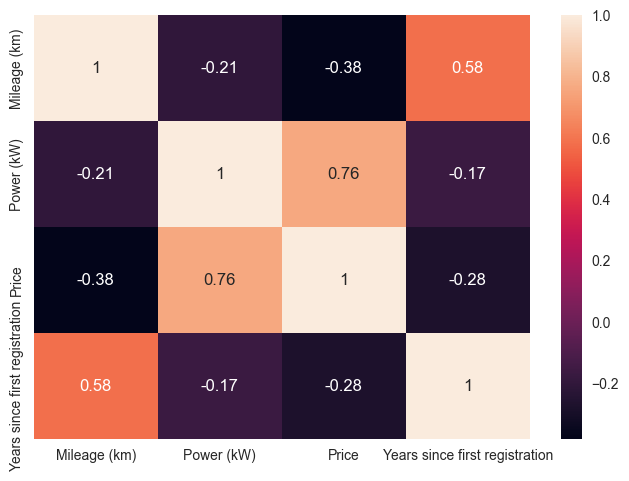

In [14]:
corelation = data.corr()
sns.heatmap(corelation, xticklabels=corelation.columns, yticklabels=corelation.columns
            ,annot=True)

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">VISUALIZING DISTRIBUTION OF VARIABLES</p>

With pairplot I visualized the relationships between numerical variables. With histogram, I explored the shape of data and the frequency of individual variables. Both showed outliers.

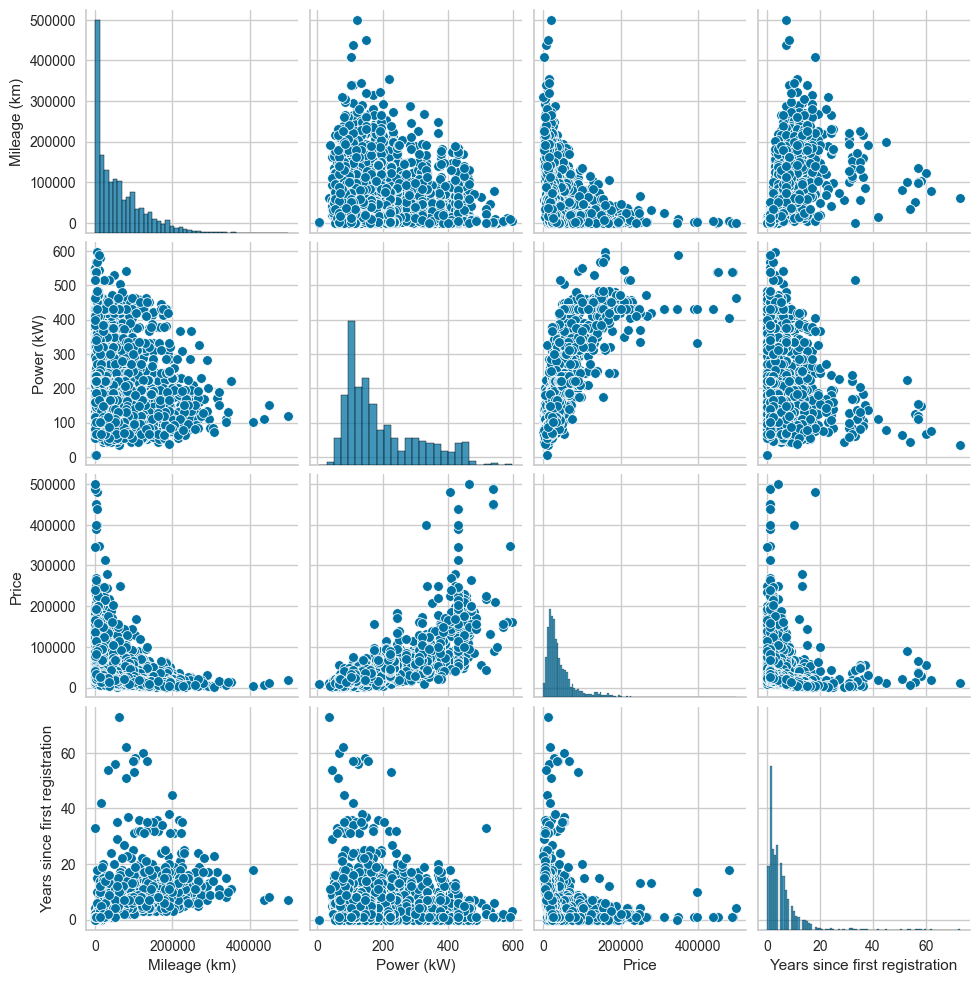

In [51]:
sns.pairplot(data)

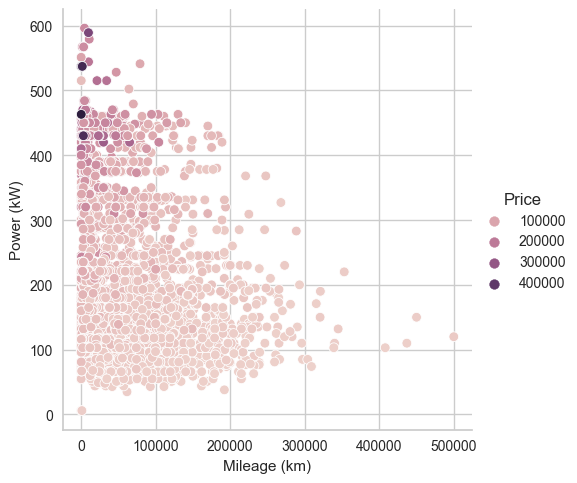

In [15]:
sns.relplot(x= 'Mileage (km)', y='Power (kW)', hue='Price', data=data)

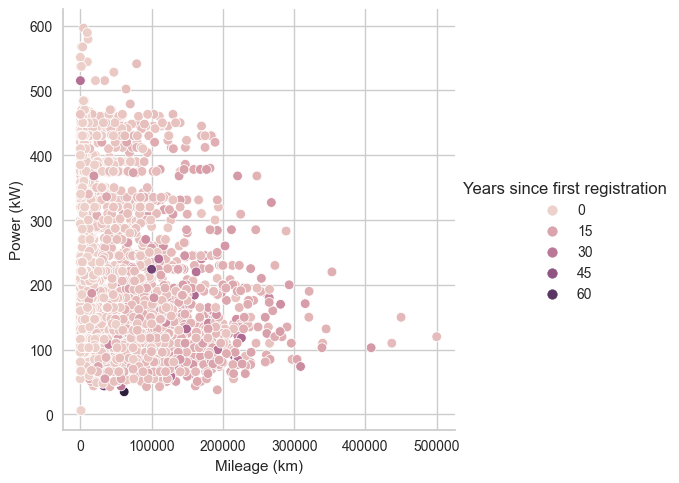

In [16]:
sns.relplot(x= 'Mileage (km)', y='Power (kW)', hue='Years since first registration', data=data)

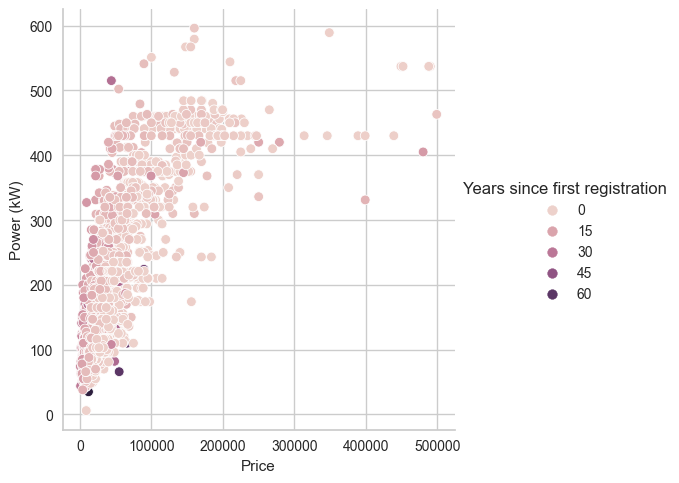

In [17]:
sns.relplot(x= 'Price', y='Power (kW)', hue='Years since first registration', data=data)

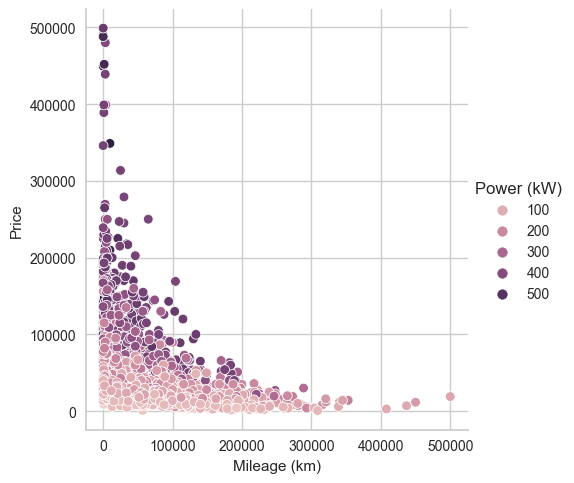

In [18]:
sns.relplot(x= 'Mileage (km)', y='Price', hue='Power (kW)', data=data)

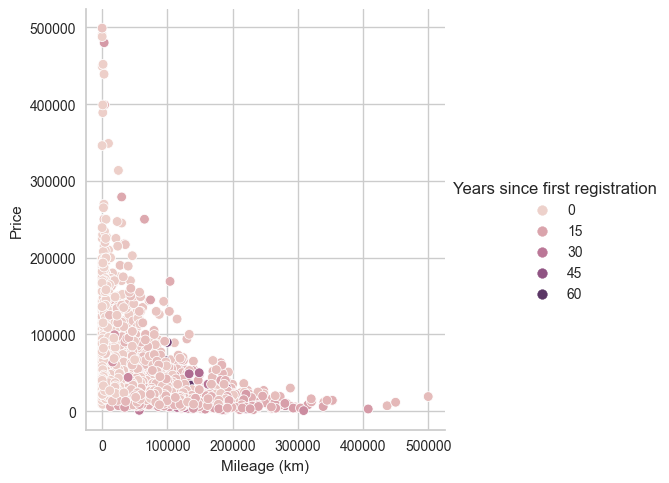

In [19]:
sns.relplot(x= 'Mileage (km)', y='Price', hue='Years since first registration', data=data)

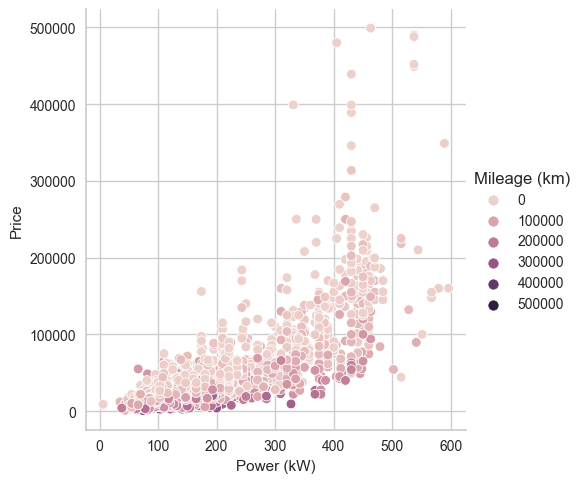

In [20]:
sns.relplot(x= 'Power (kW)', y='Price', hue='Mileage (km)', data=data)

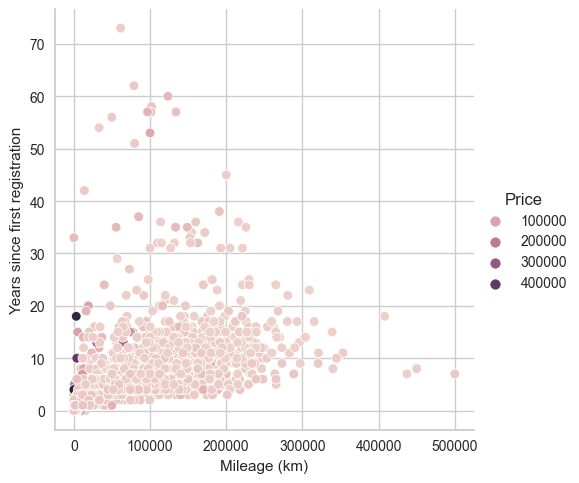

In [21]:
sns.relplot(x= 'Mileage (km)', y='Years since first registration', hue='Price', data=data)

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">FREQUENCY DISTRIBUTION OF NUMERICAL VARIABLES</p>

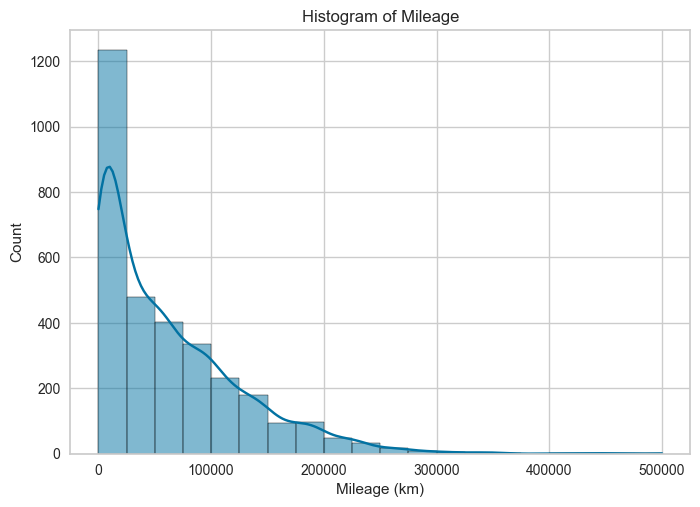

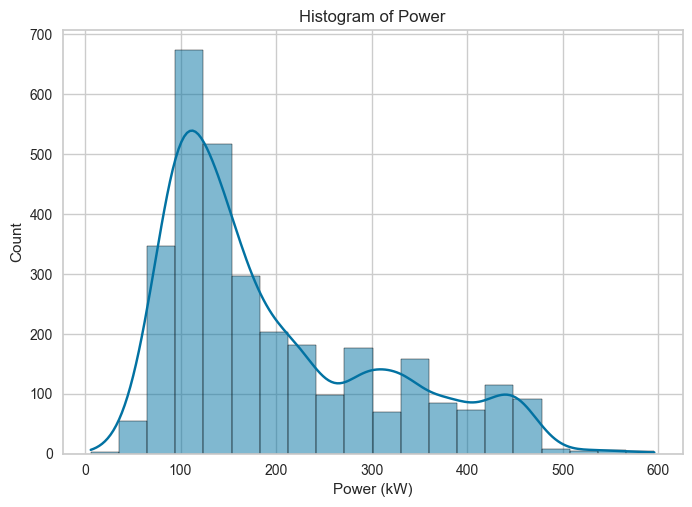

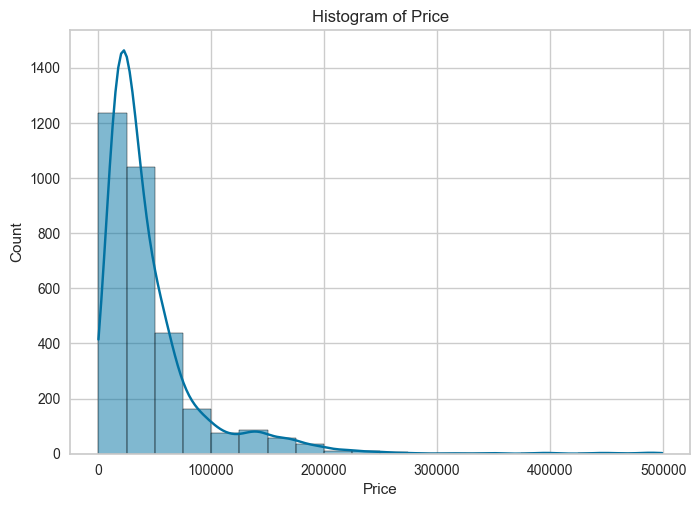

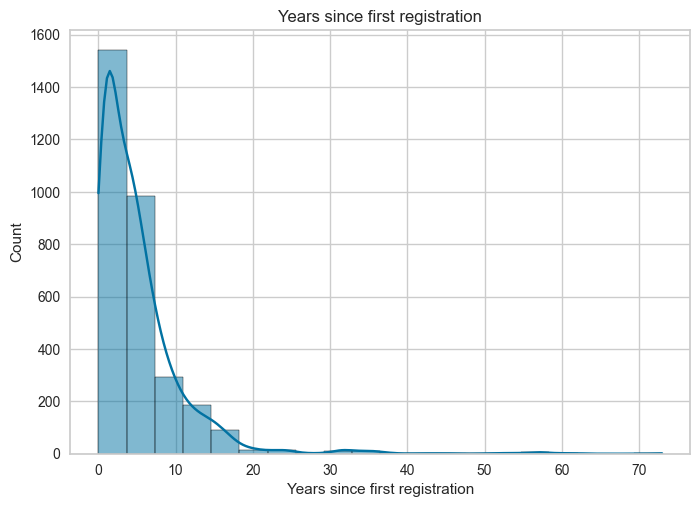

In [50]:
# Histogram for Mileage (km)
sns.histplot(data=data, x='Mileage (km)', bins=20, kde=True)
plt.title('Histogram of Mileage')
plt.xlabel('Mileage (km)')
plt.ylabel('Count')
plt.show()

# Histogram for Power (kW)
sns.histplot(data=data, x='Power (kW)', bins=20, kde=True)
plt.title('Histogram of Power')
plt.xlabel('Power (kW)')
plt.ylabel('Count')
plt.show()

# Histogram for Price
sns.histplot(data=data, x='Price', bins=20, kde=True)
plt.title('Histogram of Price')
plt.xlabel('Price')
plt.ylabel('Count')
plt.show()

# Histogram for Years since first registration
sns.histplot(data=data, x='Years since first registration', bins=20, kde=True)
plt.title('Years since first registration')
plt.xlabel('Years since first registration')
plt.ylabel('Count')
plt.show()

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">MILEAGE</p>

<Axes: xlabel='Mileage (km)', ylabel='Density'>

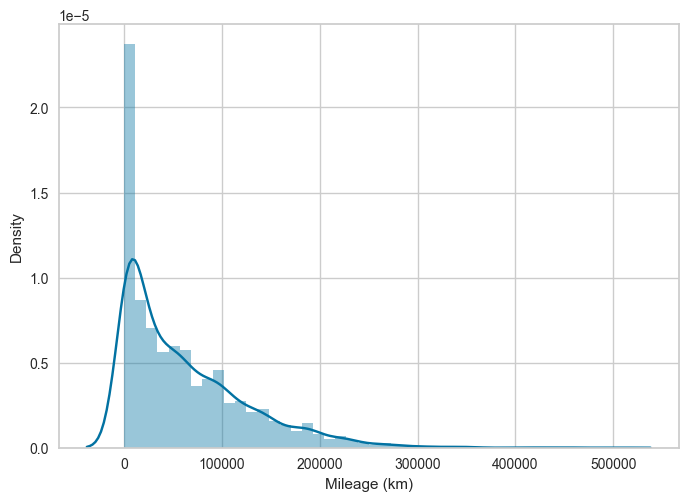

In [22]:
sns.distplot(data['Mileage (km)'])

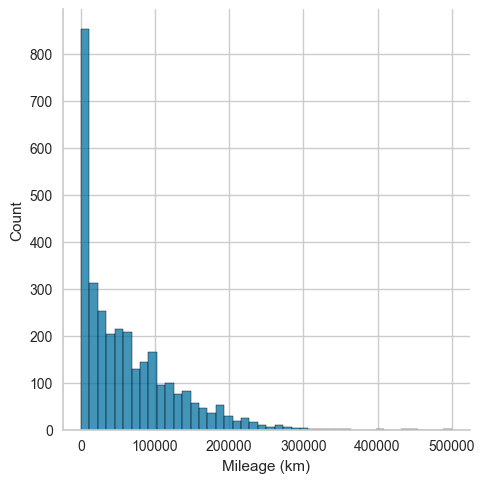

In [23]:
sns.displot(data['Mileage (km)'])

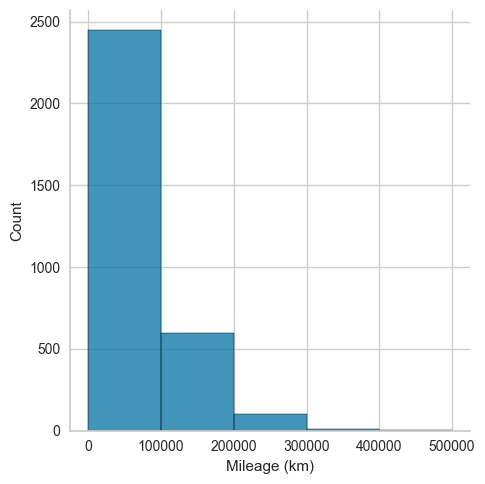

In [24]:
sns.displot(data['Mileage (km)'], bins=5)

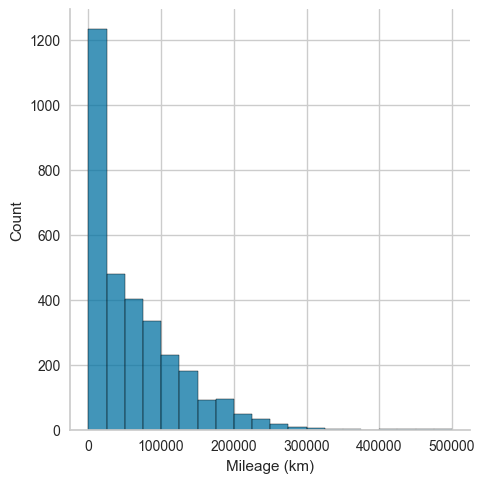

In [25]:
sns.displot(data['Mileage (km)'], bins=20)

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">POWER</p>

<Axes: xlabel='Power (kW)', ylabel='Density'>

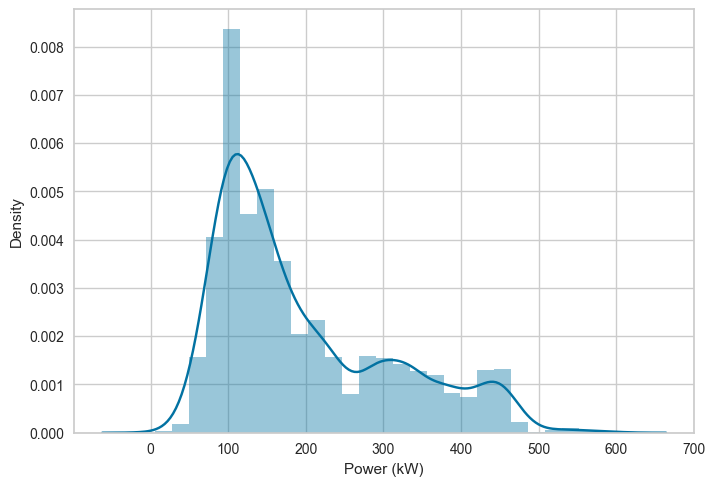

In [26]:
sns.distplot(data['Power (kW)'])

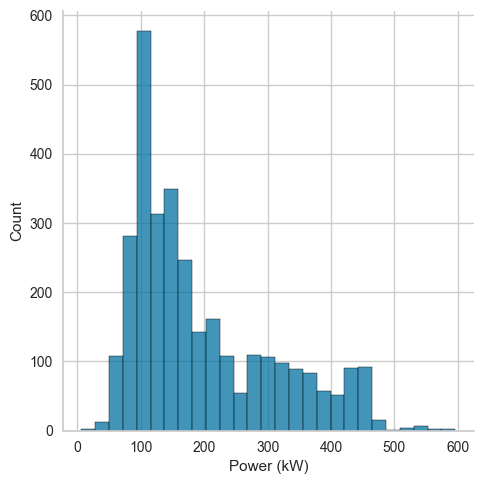

In [27]:
sns.displot(data['Power (kW)'])

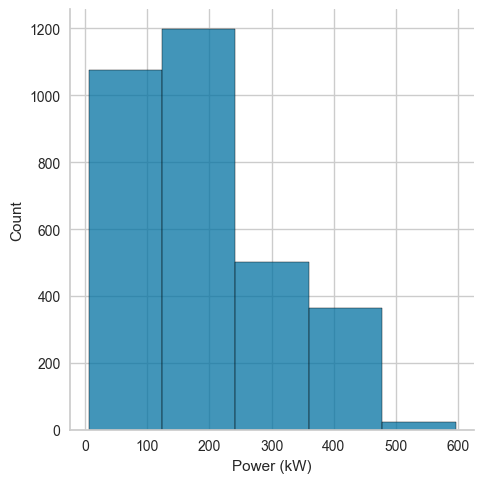

In [28]:
sns.displot(data['Power (kW)'], bins=5)

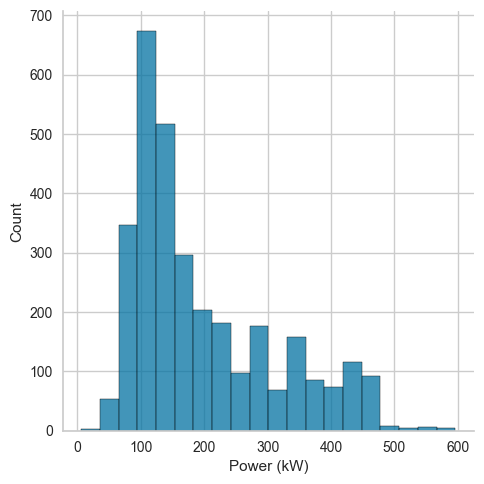

In [29]:
sns.displot(data['Power (kW)'], bins=20)

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">PRICE</p>

<Axes: xlabel='Price', ylabel='Density'>

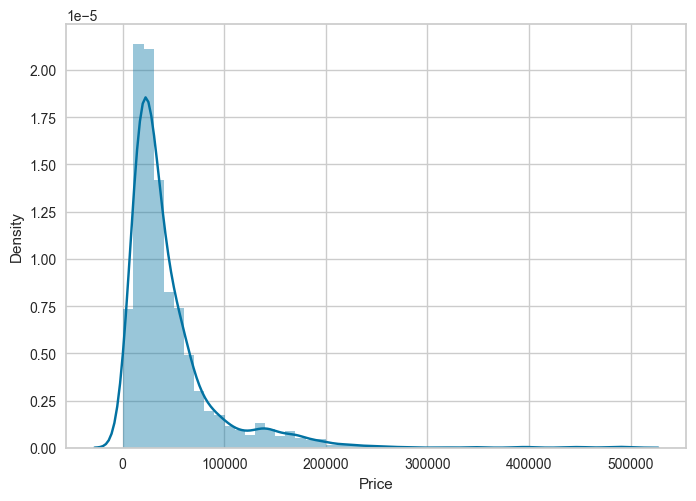

In [30]:
sns.distplot(data['Price'])

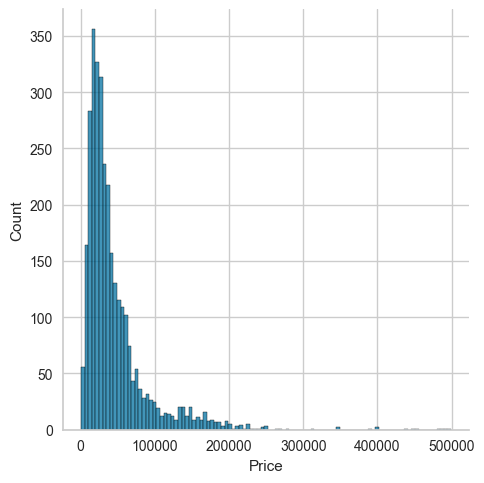

In [31]:
sns.displot(data['Price'])

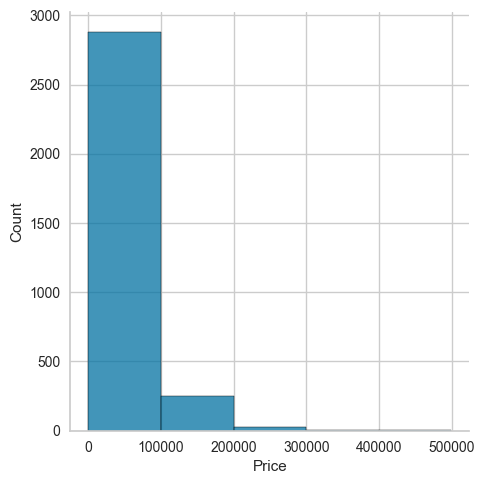

In [32]:
sns.displot(data['Price'], bins=5)

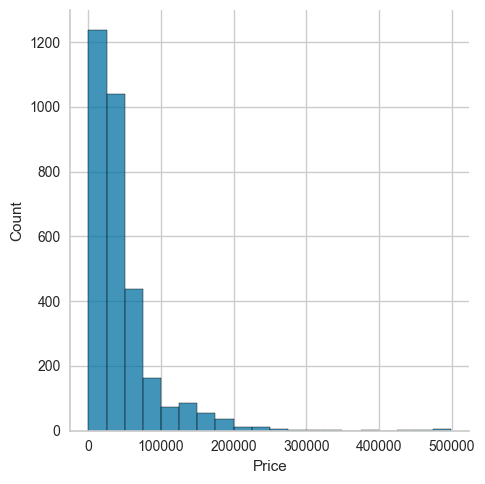

In [33]:
sns.displot(data['Price'], bins=20)

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">YEARS SINCE FIRST REGISTRATION</p>

<Axes: xlabel='Years since first registration', ylabel='Density'>

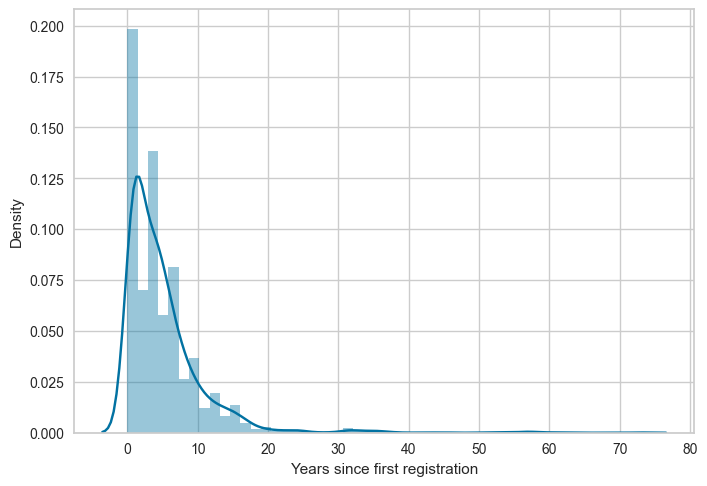

In [34]:
sns.distplot(data['Years since first registration'])

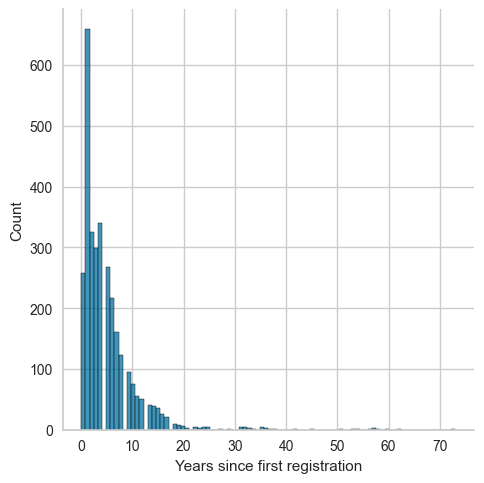

In [35]:
sns.displot(data['Years since first registration'])

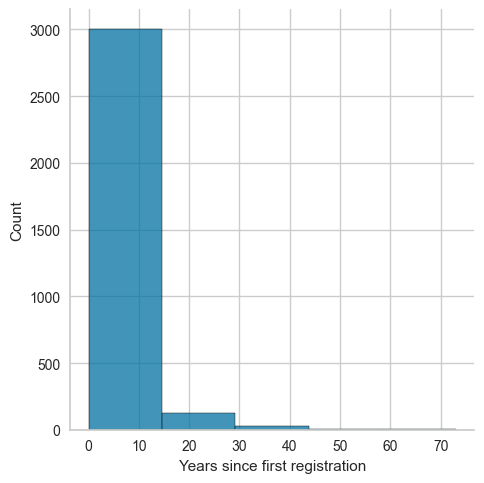

In [36]:
sns.displot(data['Years since first registration'], bins=5)

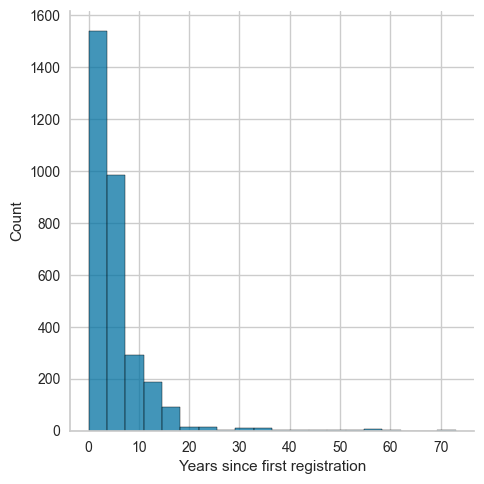

In [37]:
sns.displot(data['Years since first registration'], bins=20)

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">PARAMETERS OF NUMERICAL VARIABLES </p>

At the end of the first part boxplots graphically displayed where the outliers are, and I also execute code to calculate outliers mathematically.

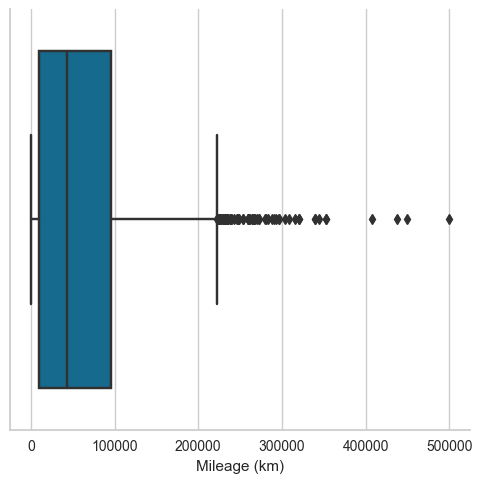

In [38]:
sns.catplot(x='Mileage (km)', kind= 'box', data= data)

In [39]:
# Use describe() method to get summary statistics of the Mileage column
desc = data['Mileage (km)'].describe()

# Print the summary statistics
print(desc)

count      3166.000000
mean      61650.700253
std       63511.091820
min           0.000000
25%        9989.500000
50%       43544.000000
75%       95169.000000
max      500000.000000
Name: Mileage (km), dtype: float64


In [40]:
# Compute summary statistics of the Mileage column
mileage_stats = data['Mileage (km)'].describe()

# Get the lower and upper quartiles and the interquartile range (IQR)
Q1 = mileage_stats['25%']
Q3 = mileage_stats['75%']
IQR = Q3 - Q1

# Compute the upper whisker
upper_whisker = Q3 + 1.5 * IQR

# Print the upper whisker
print("Upper whisker: ", upper_whisker)

Upper whisker:  222938.25


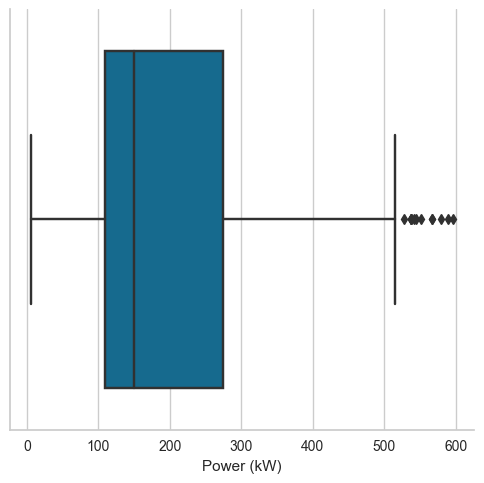

In [41]:
sns.catplot(x='Power (kW)', kind= 'box', data= data)

In [42]:
# Use describe() method to get summary statistics of the Power (kW) column
desc = data['Power (kW)'].describe()

# Print the summary statistics
print(desc)

count    3166.000000
mean      196.535060
std       113.839406
min         6.000000
25%       110.000000
50%       150.000000
75%       274.250000
max       596.000000
Name: Power (kW), dtype: float64


In [43]:
# Compute summary statistics of the Power (kW) column
mileage_stats = data['Power (kW)'].describe()

# Get the lower and upper quartiles and the interquartile range (IQR)
Q1 = mileage_stats['25%']
Q3 = mileage_stats['75%']
IQR = Q3 - Q1

# Compute the upper whisker
upper_whisker = Q3 + 1.5 * IQR

# Print the upper whisker
print("Upper whisker: ", upper_whisker)


Upper whisker:  520.625


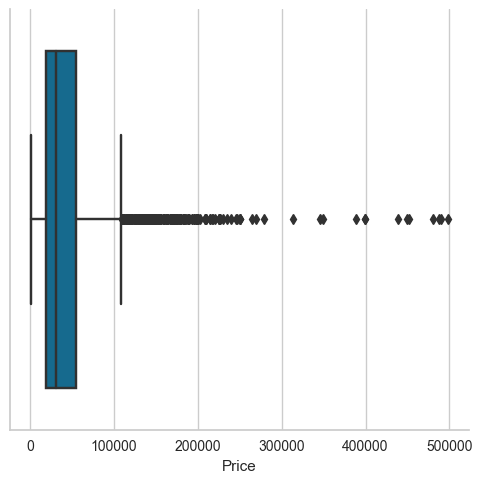

In [44]:
sns.catplot(x='Price', kind= 'box', data= data)

In [45]:
# Use describe() method to get summary statistics of the price column
desc = data['Price'].describe()

# Print the summary statistics
print(desc)

count      3166.000000
mean      45932.220152
std       47222.383412
min         600.000000
25%       18990.000000
50%       30940.000000
75%       54537.500000
max      499000.000000
Name: Price, dtype: float64


In [46]:
# Compute summary statistics of the price column
mileage_stats = data['Price'].describe()

# Get the lower and upper quartiles and the interquartile range (IQR)
Q1 = mileage_stats['25%']
Q3 = mileage_stats['75%']
IQR = Q3 - Q1

# Compute the upper whisker
upper_whisker = Q3 + 1.5 * IQR

# Print the upper whisker
print("Upper whisker: ", upper_whisker)

Upper whisker:  107858.75


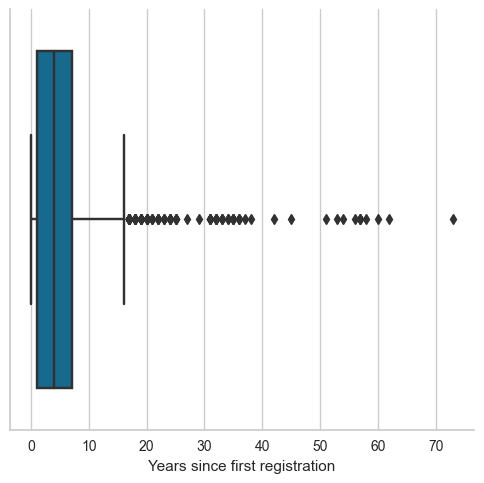

In [47]:
sns.catplot(x='Years since first registration', kind= 'box', data= data)

In [48]:
# Use describe() method to get summary statistics of the price column
desc = data['Years since first registration'].describe()

# Print the summary statistics
print(desc)

count    3166.000000
mean        5.041693
std         5.955986
min         0.000000
25%         1.000000
50%         4.000000
75%         7.000000
max        73.000000
Name: Years since first registration, dtype: float64


In [49]:
# Compute summary statistics of the price column
mileage_stats = data['Years since first registration'].describe()

# Get the lower and upper quartiles and the interquartile range (IQR)
Q1 = mileage_stats['25%']
Q3 = mileage_stats['75%']
IQR = Q3 - Q1

# Compute the upper whisker
upper_whisker = Q3 + 1.5 * IQR

# Print the upper whisker
print("Upper whisker: ", upper_whisker)

Upper whisker:  16.0


<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">FILTERING DATA TO REMOVE OUTLIERS</p>

In the second part, I first removed outliers (which I determined at the end of the first part of the analysis) and save the filtered dana for further analysis. 
Then I performed identical analysis to visualize and compare how much the data set has changed with outliers removed.

In [84]:
data = pd.read_csv('C:/Users/Ivan/Desktop/my_First_Python_Project/data/raw/autoscout24.from_base.csv')
print("Number of datapoints:", len(data))
pd.set_option('display.max_rows', None)
data

Number of datapoints: 3166


,Model,Mileage (km),Gearbox,First registration,Fuel type,Power (kW),Price,Country code,Years since first registration
0,Volvo P1800,123500,Manual,1963-07-01,Gasoline,66,54900,DE,60
1,Volvo C40,6,Automatic,2022-08-01,Electric,300,48800,ES,1
2,Volvo XC60,1,Automatic,2019-04-01,Gasoline,184,36500,ES,4
3,Volvo C40,1990,Automatic,2022-04-01,Electric,300,51600,ES,1
4,Volvo C40,8915,Automatic,2022-03-01,Electric,300,61990,BE,1
5,Volvo S60,147300,Automatic,2010-07-01,Gasoline,243,19980,DE,13
6,Volvo C30,208600,Manual,2007-01-01,Gasoline,125,5980,DE,16
7,Volvo C40,3500,Automatic,2022-11-01,Electric,300,59990,DE,1
8,Volvo XC60,127000,Automatic,2018-07-01,Electric/Gasoline,300,29990,ES,5
9,Volvo XC60,150000,Automatic,2016-09-01,Diesel,140,18985,DE,7


In [85]:
# Filter the data to remove outliers in Mileage
data = data[data['Mileage (km)'] <= 200000]
# Filter the data to remove outliers in Power (kW)
data = data[(data['Power (kW)'] >= 50) & (data['Power (kW)'] <= 400)]
# Filter the data to remove outliers in Price
data = data[data['Price'] <= 100000]
# Filter the data to remove outliers in Years since first registration
data = data[data['Years since first registration'] <= 15]
data

,Model,Mileage (km),Gearbox,First registration,Fuel type,Power (kW),Price,Country code,Years since first registration
1,Volvo C40,6,Automatic,2022-08-01,Electric,300,48800,ES,1
2,Volvo XC60,1,Automatic,2019-04-01,Gasoline,184,36500,ES,4
3,Volvo C40,1990,Automatic,2022-04-01,Electric,300,51600,ES,1
4,Volvo C40,8915,Automatic,2022-03-01,Electric,300,61990,BE,1
5,Volvo S60,147300,Automatic,2010-07-01,Gasoline,243,19980,DE,13
7,Volvo C40,3500,Automatic,2022-11-01,Electric,300,59990,DE,1
8,Volvo XC60,127000,Automatic,2018-07-01,Electric/Gasoline,300,29990,ES,5
9,Volvo XC60,150000,Automatic,2016-09-01,Diesel,140,18985,DE,7
10,Volvo XC60,146000,Automatic,2013-01-01,Diesel,120,15985,DE,10
11,Volvo XC40,1180,Automatic,2022-12-01,Electric,300,54500,ES,1


<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">SAVING FILTERED DATA SET</p>

In [86]:
data.to_csv(r'C:/Users/Ivan/Desktop/my_First_Python_Project/data/raw/autoscout24.filtered.csv', index=False)

In [87]:
data = pd.read_csv('C:/Users/Ivan/Desktop/my_First_Python_Project/data/raw/autoscout24.filtered.csv')
print("Number of datapoints:", len(data))
pd.set_option('display.max_rows', None)
data

Number of datapoints: 2597


,Model,Mileage (km),Gearbox,First registration,Fuel type,Power (kW),Price,Country code,Years since first registration
0,Volvo C40,6,Automatic,2022-08-01,Electric,300,48800,ES,1
1,Volvo XC60,1,Automatic,2019-04-01,Gasoline,184,36500,ES,4
2,Volvo C40,1990,Automatic,2022-04-01,Electric,300,51600,ES,1
3,Volvo C40,8915,Automatic,2022-03-01,Electric,300,61990,BE,1
4,Volvo S60,147300,Automatic,2010-07-01,Gasoline,243,19980,DE,13
5,Volvo C40,3500,Automatic,2022-11-01,Electric,300,59990,DE,1
6,Volvo XC60,127000,Automatic,2018-07-01,Electric/Gasoline,300,29990,ES,5
7,Volvo XC60,150000,Automatic,2016-09-01,Diesel,140,18985,DE,7
8,Volvo XC60,146000,Automatic,2013-01-01,Diesel,120,15985,DE,10
9,Volvo XC40,1180,Automatic,2022-12-01,Electric,300,54500,ES,1


<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">ANALYZING DATA WITHOUT OUTLIERS</p>

In [9]:
data.shape

(2597, 9)

In [10]:
data.describe()

,Mileage (km),Power (kW),Price,Years since first registration
count,2597.000000,2597.000000,2597.000000,2597.000000
mean,55209.651906,170.963034,35011.611860,4.192915
std,50759.258356,85.225425,20425.323256,3.448406
min,0.000000,51.000000,2990.000000,0.000000
25%,10431.000000,105.000000,19650.000000,1.000000
50%,42690.000000,140.000000,29690.000000,4.000000
75%,88498.000000,221.000000,46700.000000,6.000000
max,200000.000000,400.000000,99999.000000,15.000000


In [11]:
print(data.columns)

Index(['Model', 'Mileage (km)', 'Gearbox', 'First registration', 'Fuel type',
       'Power (kW)', 'Price', 'Country code',
       'Years since first registration'],
      dtype='object')


In [12]:
data.nunique()

Model                              325
Mileage (km)                      1897
Gearbox                              2
First registration                 182
Fuel type                            8
Power (kW)                         176
Price                             1345
Country code                         4
Years since first registration      16
dtype: int64

In [13]:
data.isnull().sum()

Model                             0
Mileage (km)                      0
Gearbox                           0
First registration                0
Fuel type                         0
Power (kW)                        0
Price                             0
Country code                      0
Years since first registration    0
dtype: int64

In [14]:
data['Gearbox'].unique()

array(['Automatic', 'Manual'], dtype=object)

In [15]:
data['Fuel type'].unique()

array(['Electric', 'Gasoline', 'Electric/Gasoline', 'Diesel',
       'Electric/Diesel', 'CNG', 'Others', 'LPG'], dtype=object)

In [16]:
data['Country code'].unique()

array(['ES', 'BE', 'DE', 'AT'], dtype=object)

In [17]:
data['Model'].unique()

array(['Volvo C40', 'Volvo XC60', 'Volvo S60', 'Volvo XC40', 'Volvo V60',
       'Volvo XC90', 'Volvo V40', 'Volvo S80', 'Volvo S90',
       'Volvo V60 Cross Country', 'Volvo V70', 'Volvo', 'Volvo V90',
       'Volvo V90 Cross Country', 'Volvo XC70', 'Volvo C70',
       'Skoda Octavia', 'Skoda Superb', 'Skoda Karoq', 'Skoda Kodiaq',
       'Skoda Enyaq', 'Skoda Fabia', 'Skoda Kamiq', 'Skoda Yeti',
       'Skoda Scala', 'Skoda Rapid/Spaceback', 'Audi A4', 'Audi A6',
       'Audi R8', 'Audi Q4 e-tron', 'Audi A5', 'Audi A3', 'Audi RS5',
       'Audi SQ2', 'Audi S1', 'Audi S3', 'Audi TT RS', 'Audi RS3',
       'Audi RS Q3', 'Audi e-tron', 'Audi Q5', 'Audi TTS', 'Audi Q7',
       'Audi S4', 'Audi A7', 'Audi S5', 'Audi TT', 'Audi e-tron GT',
       'Audi S6', 'Audi Q3', 'Audi A4 allroad', 'Audi Q2', 'Audi A1',
       'Audi A8', 'Audi S8', 'Audi SQ8', 'Audi RS4', 'Audi SQ5',
       'Audi SQ7', 'Audi Allroad', 'Audi Q8', 'Audi A6 allroad',
       'BMW 650', 'BMW 520', 'BMW M4', 'BMW 316', 'BMW

In [18]:
data['Years since first registration'].unique()

array([ 1,  4, 13,  5,  7, 10, 12,  6,  2, 15,  3,  8, 11,  0,  9, 14],
      dtype=int64)

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">CORRELATION MATRIX OF DATASET</p>

<Axes: >

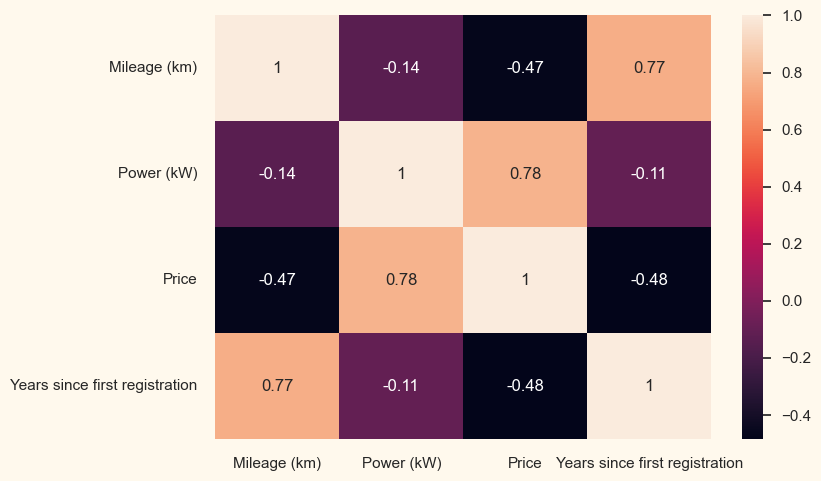

In [88]:
corelation = data.corr()
sns.heatmap(corelation, xticklabels=corelation.columns, yticklabels=corelation.columns
            ,annot=True)

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">VISUALIZING DISTRIBUTION OF VARIABLES</p>

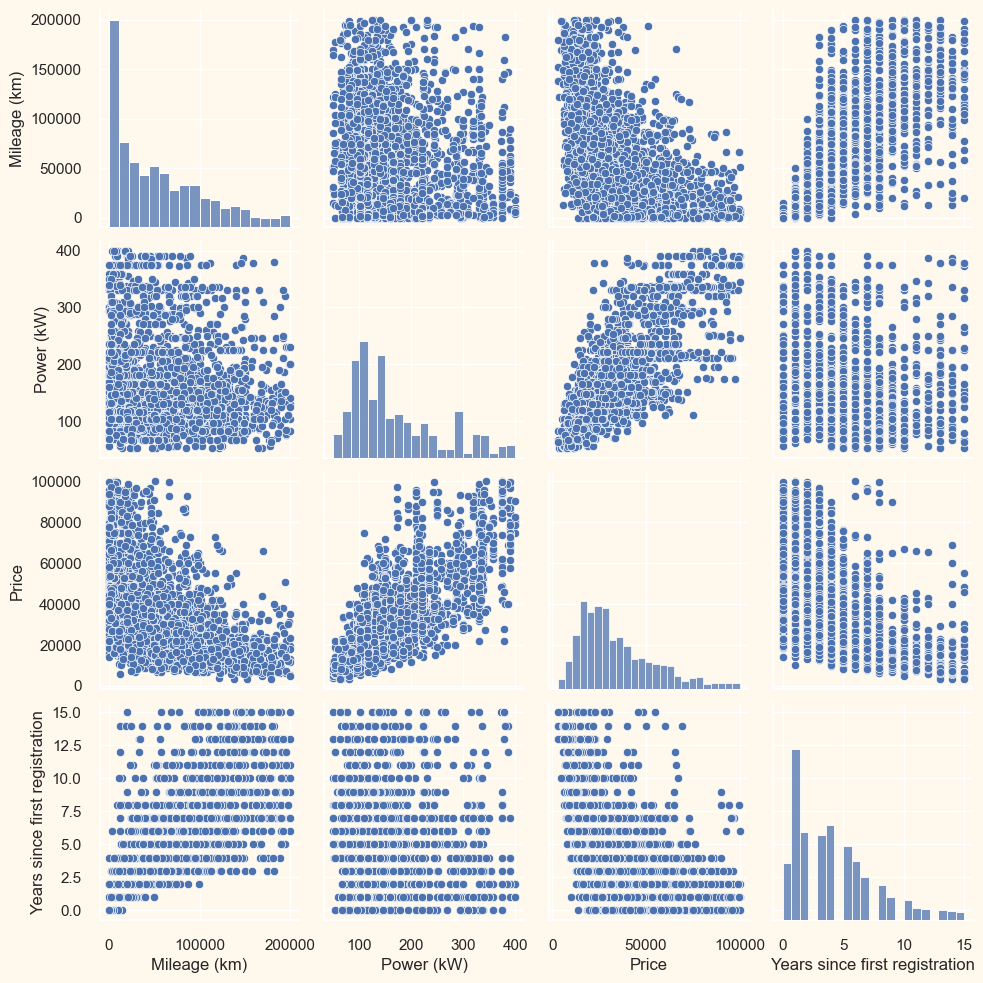

In [89]:
sns.pairplot(data)

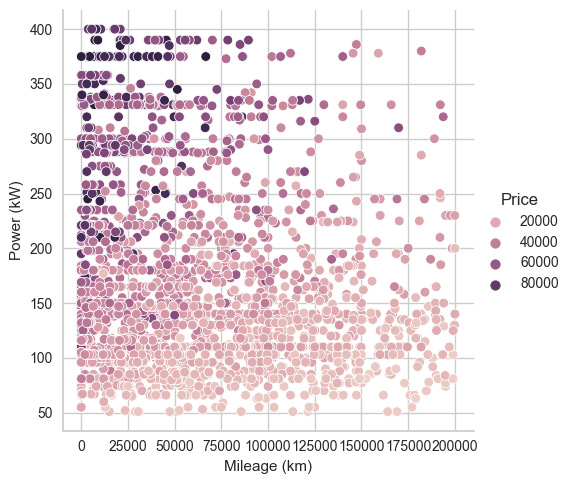

In [21]:
sns.relplot(x= 'Mileage (km)', y='Power (kW)', hue='Price', data=data)

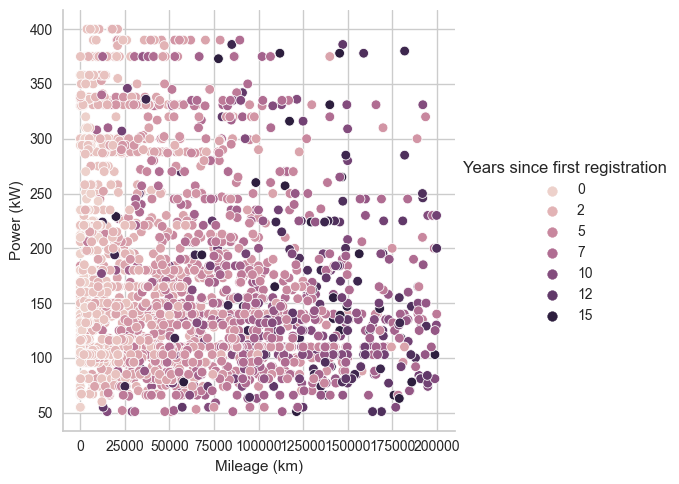

In [22]:
sns.relplot(x= 'Mileage (km)', y='Power (kW)', hue='Years since first registration', data=data)

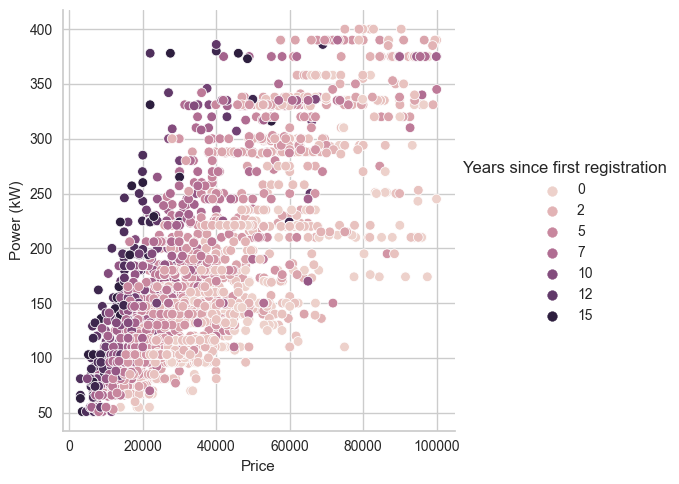

In [23]:
sns.relplot(x= 'Price', y='Power (kW)', hue='Years since first registration', data=data)

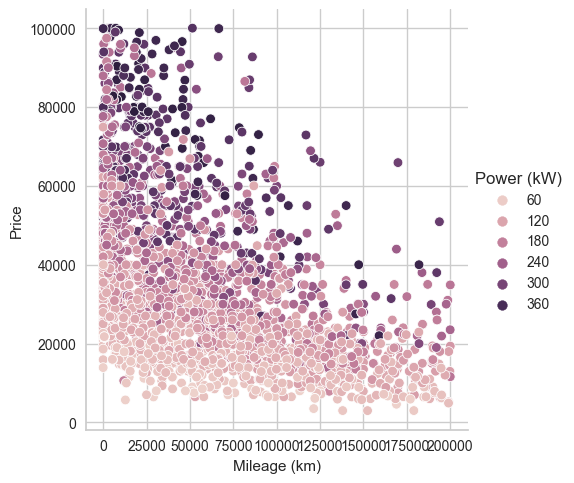

In [24]:
sns.relplot(x= 'Mileage (km)', y='Price', hue='Power (kW)', data=data)

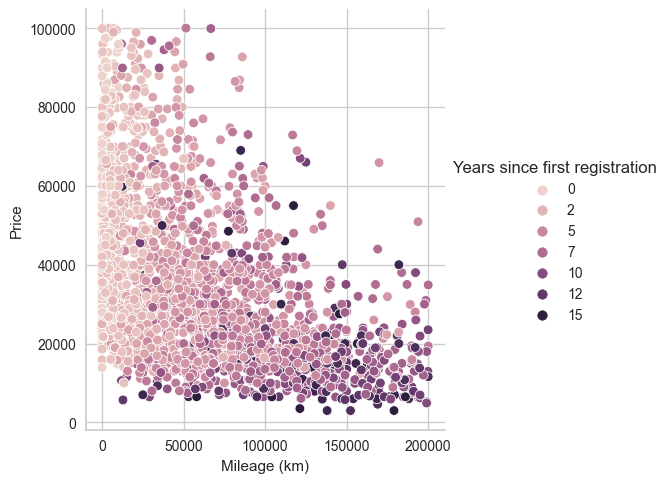

In [25]:
sns.relplot(x= 'Mileage (km)', y='Price', hue='Years since first registration', data=data)

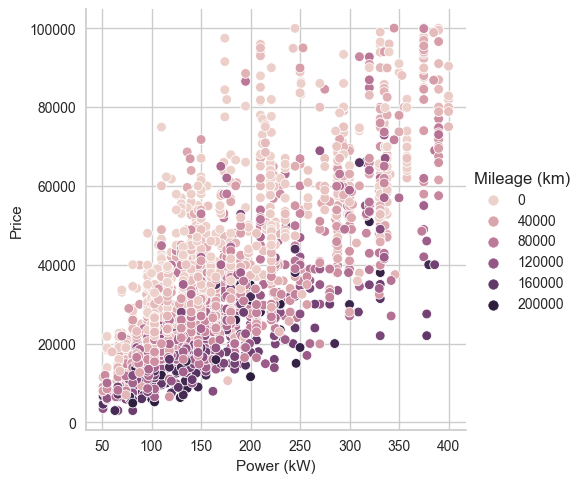

In [26]:
sns.relplot(x= 'Power (kW)', y='Price', hue='Mileage (km)', data=data)

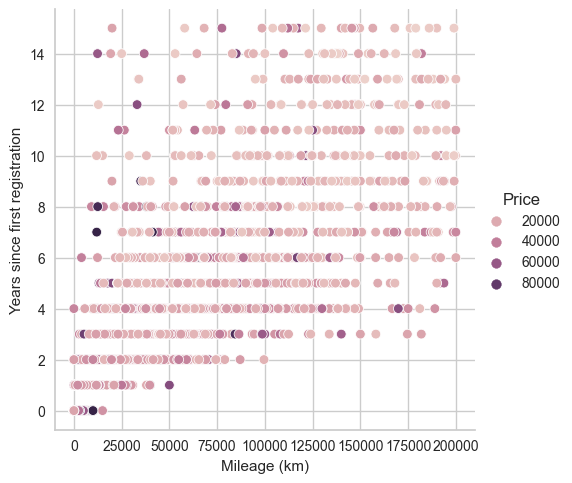

In [27]:
sns.relplot(x= 'Mileage (km)', y='Years since first registration', hue='Price', data=data)

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">FREQUENCY DISTRIBUTION OF NUMERICAL VARIABLES</p>

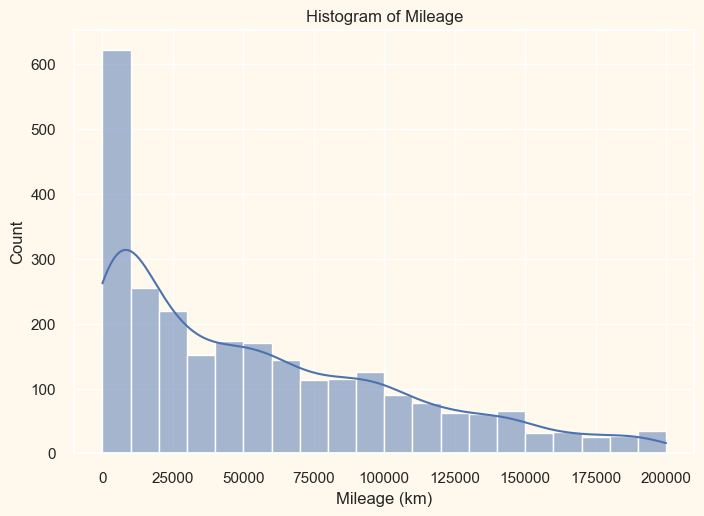

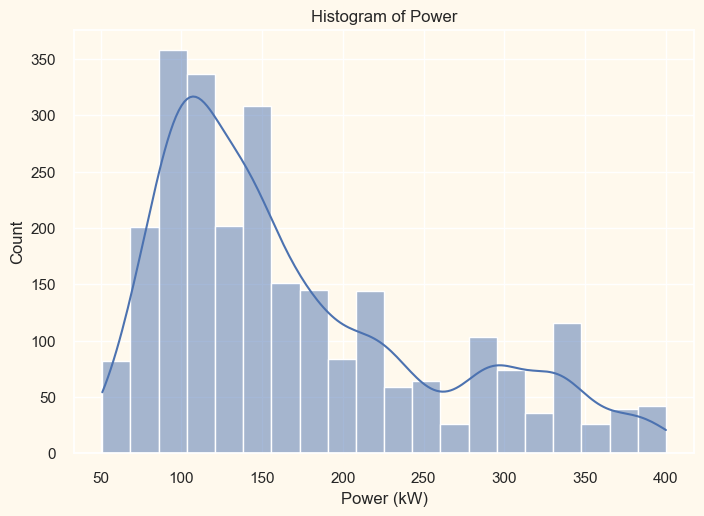

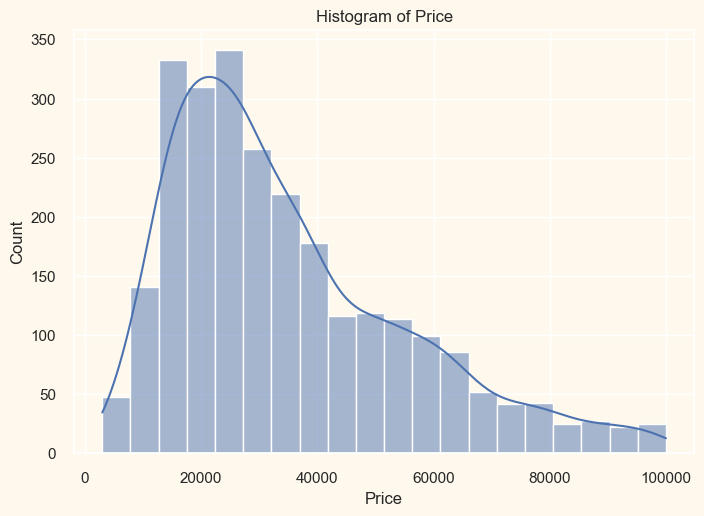

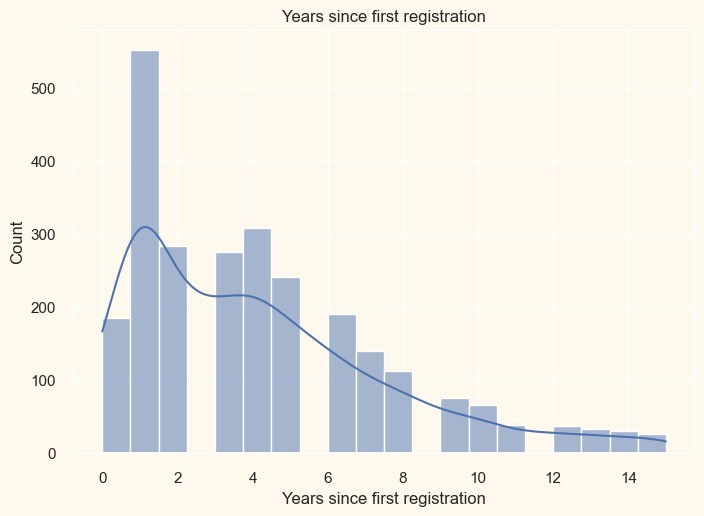

In [90]:
# Histogram for Mileage (km)
sns.histplot(data=data, x='Mileage (km)', bins=20, kde=True)
plt.title('Histogram of Mileage')
plt.xlabel('Mileage (km)')
plt.ylabel('Count')
plt.show()

# Histogram for Power (kW)
sns.histplot(data=data, x='Power (kW)', bins=20, kde=True)
plt.title('Histogram of Power')
plt.xlabel('Power (kW)')
plt.ylabel('Count')
plt.show()

# Histogram for Price
sns.histplot(data=data, x='Price', bins=20, kde=True)
plt.title('Histogram of Price')
plt.xlabel('Price')
plt.ylabel('Count')
plt.show()

# Histogram for Years since first registration
sns.histplot(data=data, x='Years since first registration', bins=20, kde=True)
plt.title('Years since first registration')
plt.xlabel('Histogram of Years since first registration')
plt.ylabel('Count')
plt.show()

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">MILEAGE</p>

<Axes: xlabel='Mileage (km)', ylabel='Density'>

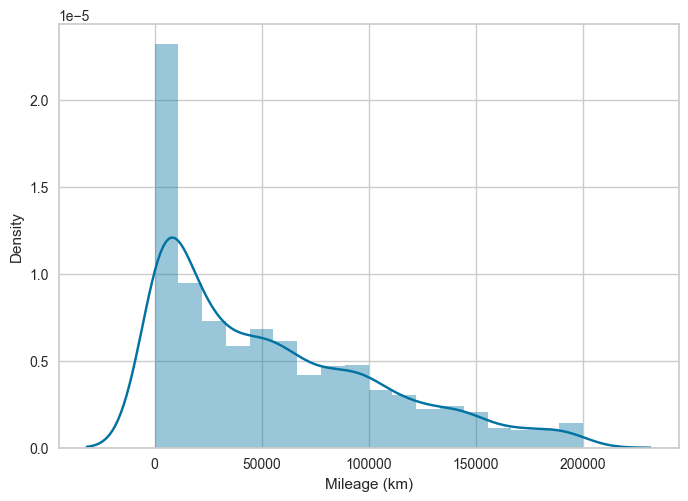

In [29]:
sns.distplot(data['Mileage (km)'])

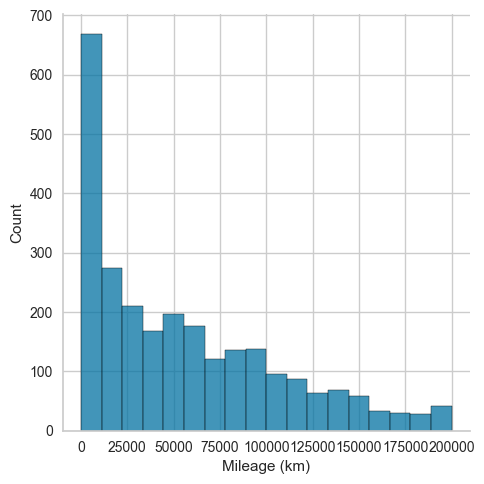

In [30]:
sns.displot(data['Mileage (km)'])

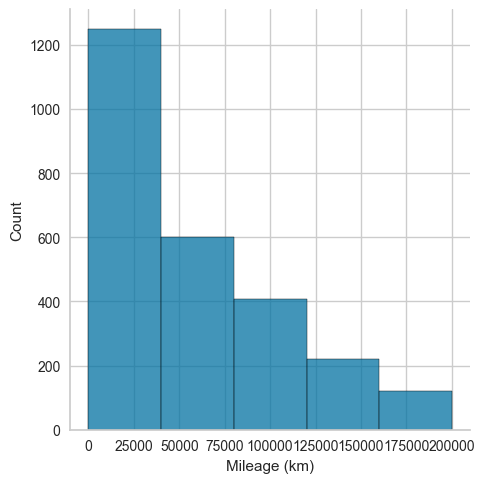

In [31]:
sns.displot(data['Mileage (km)'], bins=5)

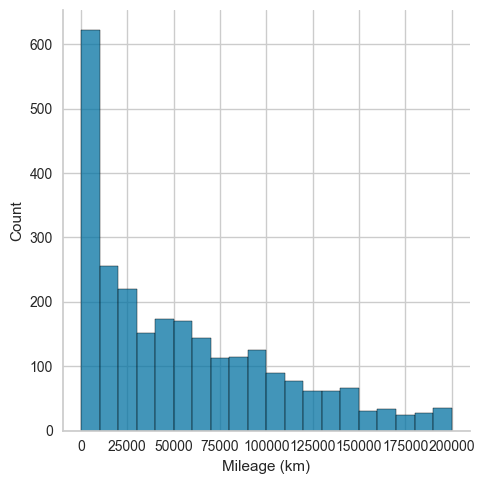

In [32]:
sns.displot(data['Mileage (km)'], bins=20)

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">POWER</p>

<Axes: xlabel='Power (kW)', ylabel='Density'>

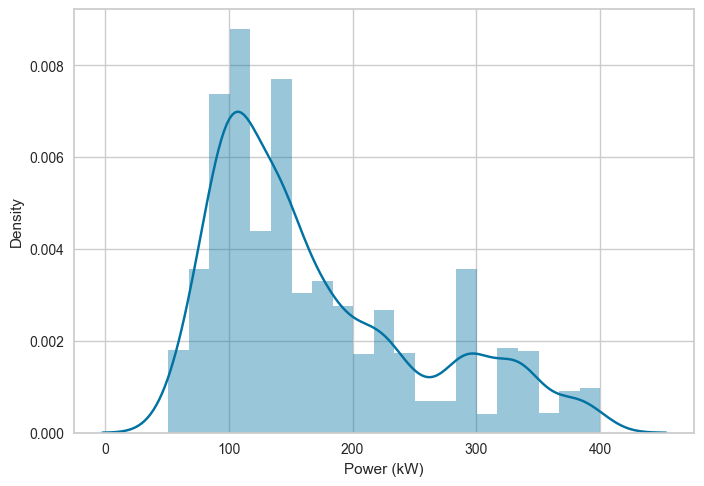

In [33]:
sns.distplot(data['Power (kW)'])

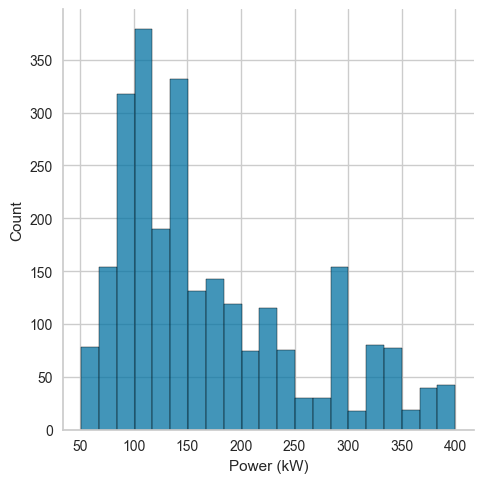

In [34]:
sns.displot(data['Power (kW)'])

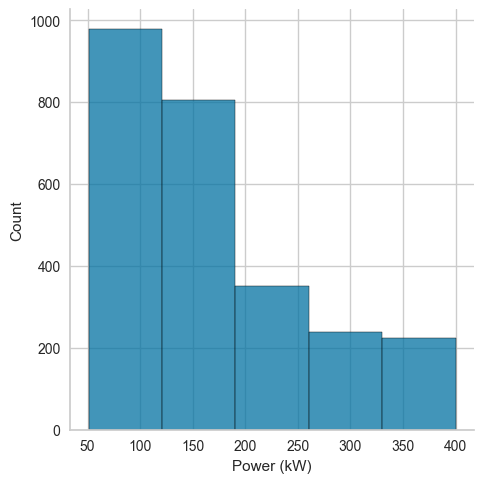

In [35]:
sns.displot(data['Power (kW)'], bins=5)

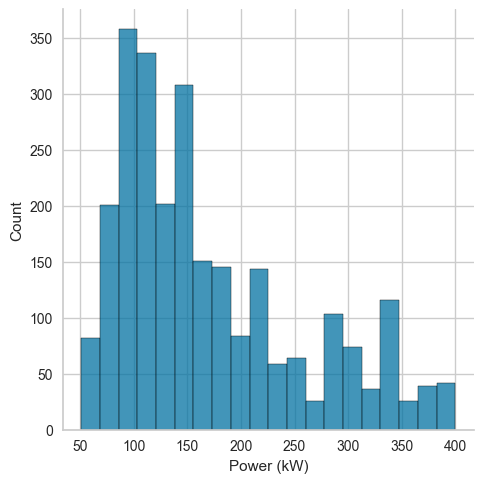

In [36]:
sns.displot(data['Power (kW)'], bins=20)

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">PRICE</p>

<Axes: xlabel='Price', ylabel='Density'>

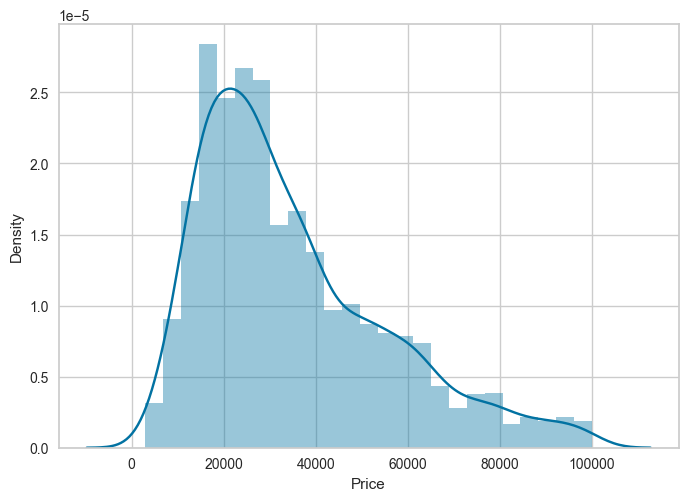

In [37]:
sns.distplot(data['Price'])

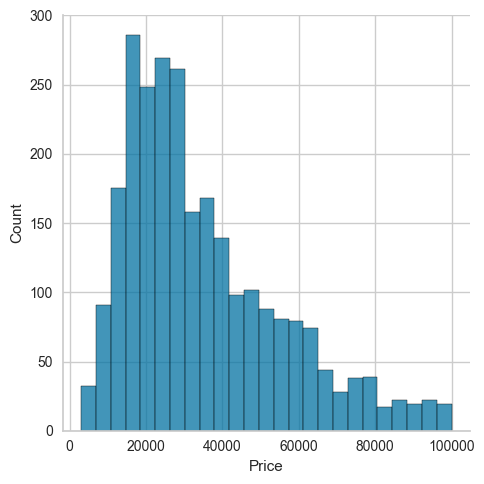

In [38]:
sns.displot(data['Price'])

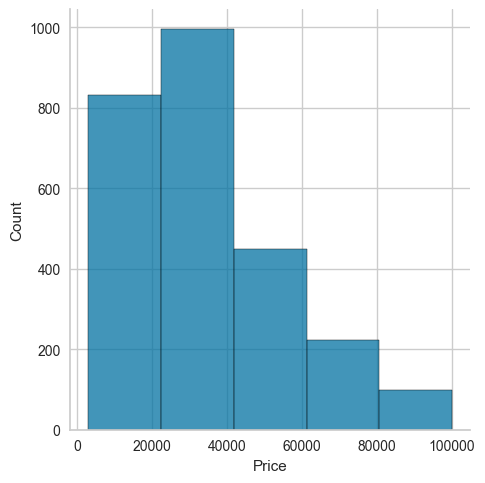

In [39]:
sns.displot(data['Price'], bins=5)

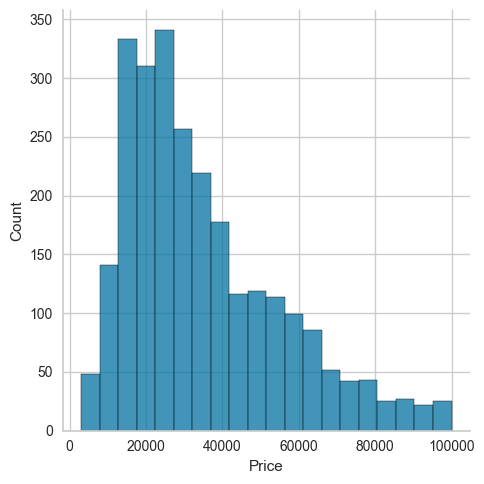

In [40]:
sns.displot(data['Price'], bins=20)

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">YEARS SINCE FIRST REGISTRATION</p>

<Axes: xlabel='Years since first registration', ylabel='Density'>

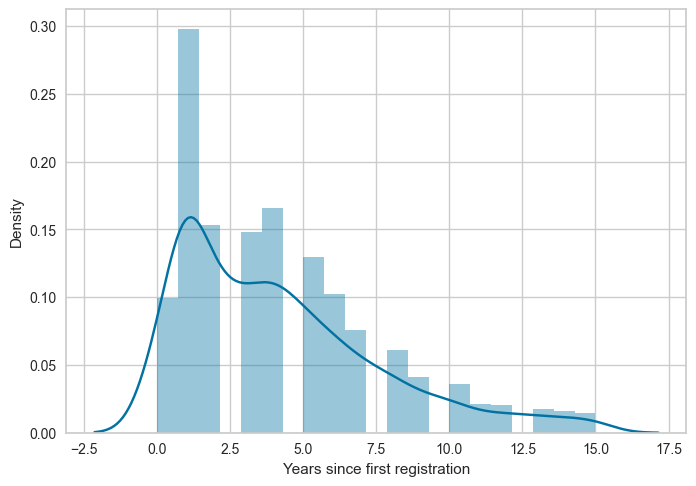

In [41]:
sns.distplot(data['Years since first registration'])

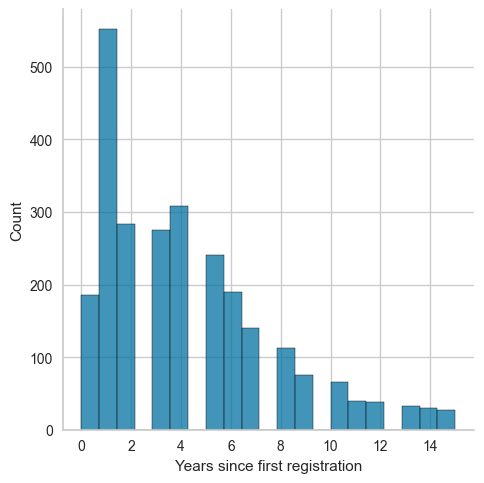

In [42]:
sns.displot(data['Years since first registration'])

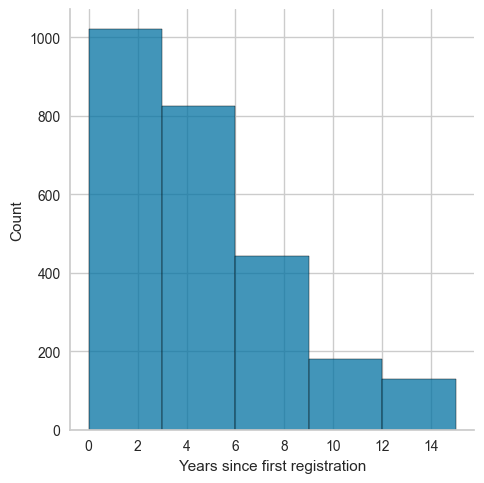

In [43]:
sns.displot(data['Years since first registration'], bins=5)

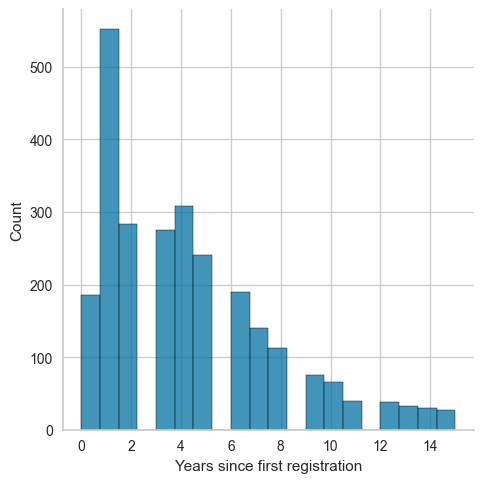

In [44]:
sns.displot(data['Years since first registration'], bins=20)

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">PARAMETERS OF NUMERICAL VARIABLES </p>

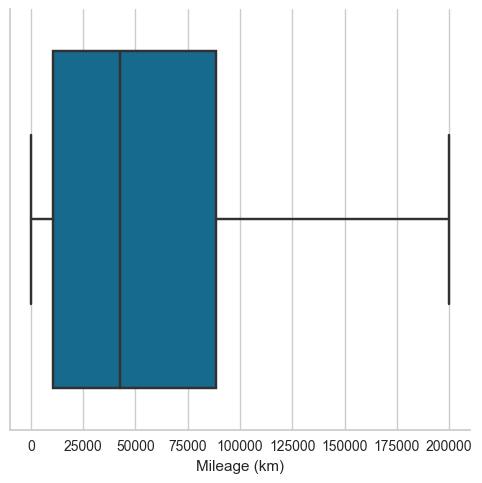

In [45]:
sns.catplot(x='Mileage (km)', kind= 'box', data= data)

In [46]:
# Use describe() method to get summary statistics of the Mileage column
desc = data['Mileage (km)'].describe()

# Print the summary statistics
print(desc)

count      2597.000000
mean      55209.651906
std       50759.258356
min           0.000000
25%       10431.000000
50%       42690.000000
75%       88498.000000
max      200000.000000
Name: Mileage (km), dtype: float64


In [47]:
# Compute summary statistics of the Mileage column
mileage_stats = data['Mileage (km)'].describe()

# Get the lower and upper quartiles and the interquartile range (IQR)
Q1 = mileage_stats['25%']
Q3 = mileage_stats['75%']
IQR = Q3 - Q1

# Compute the upper whisker
upper_whisker = Q3 + 1.5 * IQR

# Print the upper whisker
print("Upper whisker: ", upper_whisker)

Upper whisker:  205598.5


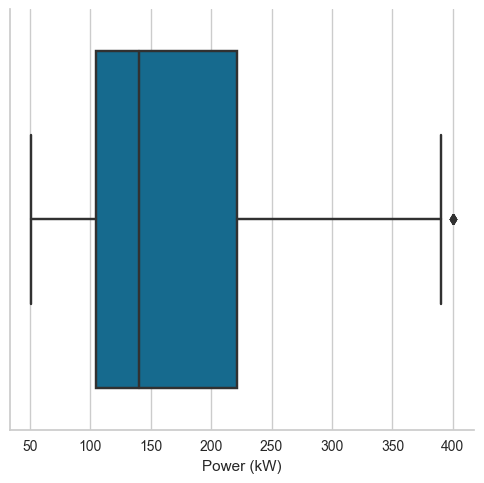

In [48]:
sns.catplot(x='Power (kW)', kind= 'box', data= data)

In [49]:
# Use describe() method to get summary statistics of the Power (kW) column
desc = data['Power (kW)'].describe()

# Print the summary statistics
print(desc)

count    2597.000000
mean      170.963034
std        85.225425
min        51.000000
25%       105.000000
50%       140.000000
75%       221.000000
max       400.000000
Name: Power (kW), dtype: float64


In [50]:
# Compute summary statistics of the Power (kW) column
mileage_stats = data['Power (kW)'].describe()

# Get the lower and upper quartiles and the interquartile range (IQR)
Q1 = mileage_stats['25%']
Q3 = mileage_stats['75%']
IQR = Q3 - Q1

# Compute the upper whisker
upper_whisker = Q3 + 1.5 * IQR

# Print the upper whisker
print("Upper whisker: ", upper_whisker)


Upper whisker:  395.0


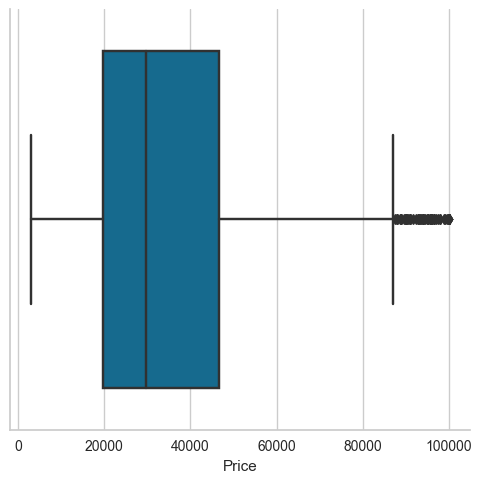

In [51]:
sns.catplot(x='Price', kind= 'box', data= data)

In [52]:
# Use describe() method to get summary statistics of the price column
desc = data['Price'].describe()

# Print the summary statistics
print(desc)

count     2597.000000
mean     35011.611860
std      20425.323256
min       2990.000000
25%      19650.000000
50%      29690.000000
75%      46700.000000
max      99999.000000
Name: Price, dtype: float64


In [53]:
# Compute summary statistics of the price column
mileage_stats = data['Price'].describe()

# Get the lower and upper quartiles and the interquartile range (IQR)
Q1 = mileage_stats['25%']
Q3 = mileage_stats['75%']
IQR = Q3 - Q1

# Compute the upper whisker
upper_whisker = Q3 + 1.5 * IQR

# Print the upper whisker
print("Upper whisker: ", upper_whisker)

Upper whisker:  87275.0


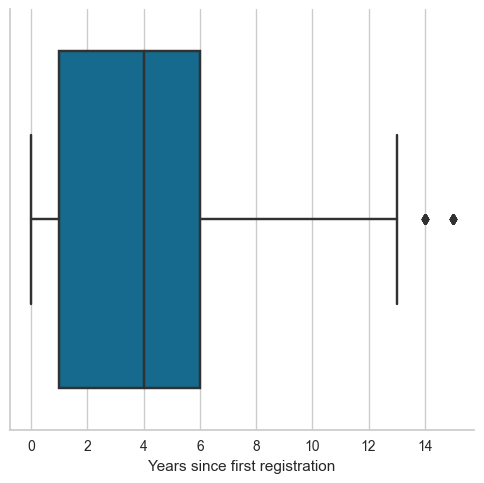

In [54]:
sns.catplot(x='Years since first registration', kind= 'box', data= data)

In [55]:
# Use describe() method to get summary statistics of the price column
desc = data['Years since first registration'].describe()

# Print the summary statistics
print(desc)

count    2597.000000
mean        4.192915
std         3.448406
min         0.000000
25%         1.000000
50%         4.000000
75%         6.000000
max        15.000000
Name: Years since first registration, dtype: float64


In [56]:
# Compute summary statistics of the price column
mileage_stats = data['Years since first registration'].describe()

# Get the lower and upper quartiles and the interquartile range (IQR)
Q1 = mileage_stats['25%']
Q3 = mileage_stats['75%']
IQR = Q3 - Q1

# Compute the upper whisker
upper_whisker = Q3 + 1.5 * IQR

# Print the upper whisker
print("Upper whisker: ", upper_whisker)

Upper whisker:  13.5


<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">LOADING DATA</p>

 In the third and last part, I mostly relied on the example we worked on in the class. 
Based on what we did, I applied it to my dataset to get a better insight and apply in practice what we did in class. 
    For this part, I saved the data set as analysis.csv.

In [92]:
#Loading the dataset
data = pd.read_csv('C:/Users/Ivan/Desktop/my_First_Python_Project/data/raw/autoscout24.filtered.csv')
print("Number of datapoints:", len(data))
pd.set_option('display.max_rows', None)
data

Number of datapoints: 2597


,Model,Mileage (km),Gearbox,First registration,Fuel type,Power (kW),Price,Country code,Years since first registration
0,Volvo C40,6,Automatic,2022-08-01,Electric,300,48800,ES,1
1,Volvo XC60,1,Automatic,2019-04-01,Gasoline,184,36500,ES,4
2,Volvo C40,1990,Automatic,2022-04-01,Electric,300,51600,ES,1
3,Volvo C40,8915,Automatic,2022-03-01,Electric,300,61990,BE,1
4,Volvo S60,147300,Automatic,2010-07-01,Gasoline,243,19980,DE,13
5,Volvo C40,3500,Automatic,2022-11-01,Electric,300,59990,DE,1
6,Volvo XC60,127000,Automatic,2018-07-01,Electric/Gasoline,300,29990,ES,5
7,Volvo XC60,150000,Automatic,2016-09-01,Diesel,140,18985,DE,7
8,Volvo XC60,146000,Automatic,2013-01-01,Diesel,120,15985,DE,10
9,Volvo XC40,1180,Automatic,2022-12-01,Electric,300,54500,ES,1


In [93]:
data.to_csv(r'C:/Users/Ivan/Desktop/my_First_Python_Project/data/raw/autoscout24.analysis.csv', index=False)

In [111]:
#Loading the dataset
data = pd.read_csv('C:/Users/Ivan/Desktop/my_First_Python_Project/data/raw/autoscout24.analysis.csv')
print("Number of datapoints:", len(data))
pd.set_option('display.max_rows', None)
data

Number of datapoints: 2597


,Model,Mileage (km),Gearbox,First registration,Fuel type,Power (kW),Price,Country code,Years since first registration
0,Volvo C40,6,Automatic,2022-08-01,Electric,300,48800,ES,1
1,Volvo XC60,1,Automatic,2019-04-01,Gasoline,184,36500,ES,4
2,Volvo C40,1990,Automatic,2022-04-01,Electric,300,51600,ES,1
3,Volvo C40,8915,Automatic,2022-03-01,Electric,300,61990,BE,1
4,Volvo S60,147300,Automatic,2010-07-01,Gasoline,243,19980,DE,13
5,Volvo C40,3500,Automatic,2022-11-01,Electric,300,59990,DE,1
6,Volvo XC60,127000,Automatic,2018-07-01,Electric/Gasoline,300,29990,ES,5
7,Volvo XC60,150000,Automatic,2016-09-01,Diesel,140,18985,DE,7
8,Volvo XC60,146000,Automatic,2013-01-01,Diesel,120,15985,DE,10
9,Volvo XC40,1180,Automatic,2022-12-01,Electric,300,54500,ES,1


<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">DATA SCREENING</p>

Given that I cleaned the data and removed outliers in the previous steps, I did not deal with it much. 
For this reason, instead of data cleaning, I called it data screening. 
In this step, I examined the information related to the dataset that I have.

In [71]:
#Information on features 
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2597 entries, 0 to 2596
Data columns (total 9 columns):
 #   Column                          Non-Null Count  Dtype 
---  ------                          --------------  ----- 
 0   Model                           2597 non-null   object
 1   Mileage (km)                    2597 non-null   int64 
 2   Gearbox                         2597 non-null   object
 3   First registration              2597 non-null   object
 4   Fuel type                       2597 non-null   object
 5   Power (kW)                      2597 non-null   int64 
 6   Price                           2597 non-null   int64 
 7   Country code                    2597 non-null   object
 8   Years since first registration  2597 non-null   int64 
dtypes: int64(4), object(5)
memory usage: 182.7+ KB


In [6]:
data['First registration'] = pd.to_datetime(data['First registration'])
dates = []
for i in data['First registration']:
    i = i.date()
    dates.append(i)  
#Dates of the newest and oldest auto in advertisements
print("The newest auto in advertisements:",max(dates))
print("The oldest auto in advertisements:",min(dates))

The newest auto in advertisements: 2023-05-01
The oldest auto in advertisements: 2008-01-01


In [7]:
dates

[datetime.date(2022, 8, 1),
 datetime.date(2019, 4, 1),
 datetime.date(2022, 4, 1),
 datetime.date(2022, 3, 1),
 datetime.date(2010, 7, 1),
 datetime.date(2022, 11, 1),
 datetime.date(2018, 7, 1),
 datetime.date(2016, 9, 1),
 datetime.date(2013, 1, 1),
 datetime.date(2022, 12, 1),
 datetime.date(2019, 10, 1),
 datetime.date(2013, 12, 1),
 datetime.date(2016, 11, 1),
 datetime.date(2022, 1, 1),
 datetime.date(2011, 1, 1),
 datetime.date(2022, 1, 1),
 datetime.date(2022, 9, 1),
 datetime.date(2022, 1, 1),
 datetime.date(2017, 1, 1),
 datetime.date(2021, 10, 1),
 datetime.date(2022, 10, 1),
 datetime.date(2008, 1, 1),
 datetime.date(2018, 2, 1),
 datetime.date(2019, 2, 1),
 datetime.date(2017, 12, 1),
 datetime.date(2022, 9, 1),
 datetime.date(2022, 11, 1),
 datetime.date(2020, 10, 1),
 datetime.date(2017, 2, 1),
 datetime.date(2017, 10, 1),
 datetime.date(2021, 4, 1),
 datetime.date(2022, 4, 1),
 datetime.date(2018, 11, 1),
 datetime.date(2020, 2, 1),
 datetime.date(2018, 3, 1),
 datetim

In [8]:
days = []
d1 = max(dates) 
print(d1)
for i in dates:
    delta = d1 - i
    days.append(delta)
data["Old_in_days"] = days
data["Old_in_days"] = pd.to_numeric(data["Old_in_days"], errors="coerce")

2023-05-01


In [9]:
data["Old_in_days"]

0        23587200000000000
1       128822400000000000
2        34128000000000000
3        36806400000000000
4       404956800000000000
5        15638400000000000
6       152496000000000000
7       210211200000000000
8       325900800000000000
9        13046400000000000
10      113011200000000000
11      297043200000000000
12      204940800000000000
13       41904000000000000
14      389059200000000000
15       41904000000000000
16       20908800000000000
17       41904000000000000
18      199670400000000000
19       49852800000000000
20       18316800000000000
21      483753600000000000
22      165456000000000000
23      133920000000000000
24      170812800000000000
25       20908800000000000
26       15638400000000000
27       81388800000000000
28      196992000000000000
29      176083200000000000
30       65664000000000000
31       34128000000000000
32      141868800000000000
33      102384000000000000
34      163036800000000000
35      199670400000000000
36      247190400000000000
3

Exploring the unique values in the categorical features to get a clear idea of the data.

In [10]:
print("Total categories in the feature \"Fuel type\":\n", data["Fuel type"].value_counts(), "\n")
print("Total categories in the feature \"Country code\":\n", data["Country code"].value_counts(), "\n")
print("Total categories in the feature Gearbox:\n", data["Gearbox"].value_counts(), "\n")
print("Total categories in the feature \"Years since first registration\":\n", data["Years since first registration"].value_counts())

Total categories in the feature "Fuel type":
 Gasoline             1330
Diesel                752
Electric/Gasoline     263
Electric              237
Others                  6
Electric/Diesel         5
CNG                     3
LPG                     1
Name: Fuel type, dtype: int64 

Total categories in the feature "Country code":
 DE    1763
BE     497
ES     296
AT      41
Name: Country code, dtype: int64 

Total categories in the feature Gearbox:
 Automatic    1908
Manual        689
Name: Gearbox, dtype: int64 

Total categories in the feature "Years since first registration":
 1     552
4     308
2     284
3     275
5     241
6     190
0     185
7     140
8     113
9      76
10     66
11     39
12     38
13     33
14     30
15     27
Name: Years since first registration, dtype: int64


In [11]:
print("Total categories in the feature Model:\n", data["Model"].value_counts())

Total categories in the feature Model:
 Volvo XC60                    80
Volkswagen Golf               75
Skoda Octavia                 67
Volvo XC90                    63
Opel Astra                    61
Renault Megane                58
Ford Mustang                  55
Opel Grandland X              54
Volvo XC40                    44
Renault Captur                42
Volvo V60                     41
Skoda Kodiaq                  41
Skoda Superb                  40
Opel Corsa                    40
Ford Mustang Mach-E           39
Skoda Karoq                   39
Renault Clio                  37
Ford Kuga                     34
Opel Insignia                 34
Opel Crossland                33
Volkswagen T-Roc              31
Ford Focus                    30
Opel Crossland X              28
Skoda Scala                   27
Volvo C40                     27
Ford Fiesta                   25
Audi A5                       24
Volvo S60                     24
Volvo S90                     23
Sko

To take a look at the broader view of the data I will plot some of the selected features.

Relative Plot Of Some Selected Features: A Data Subset


<Figure size 800x550 with 0 Axes>

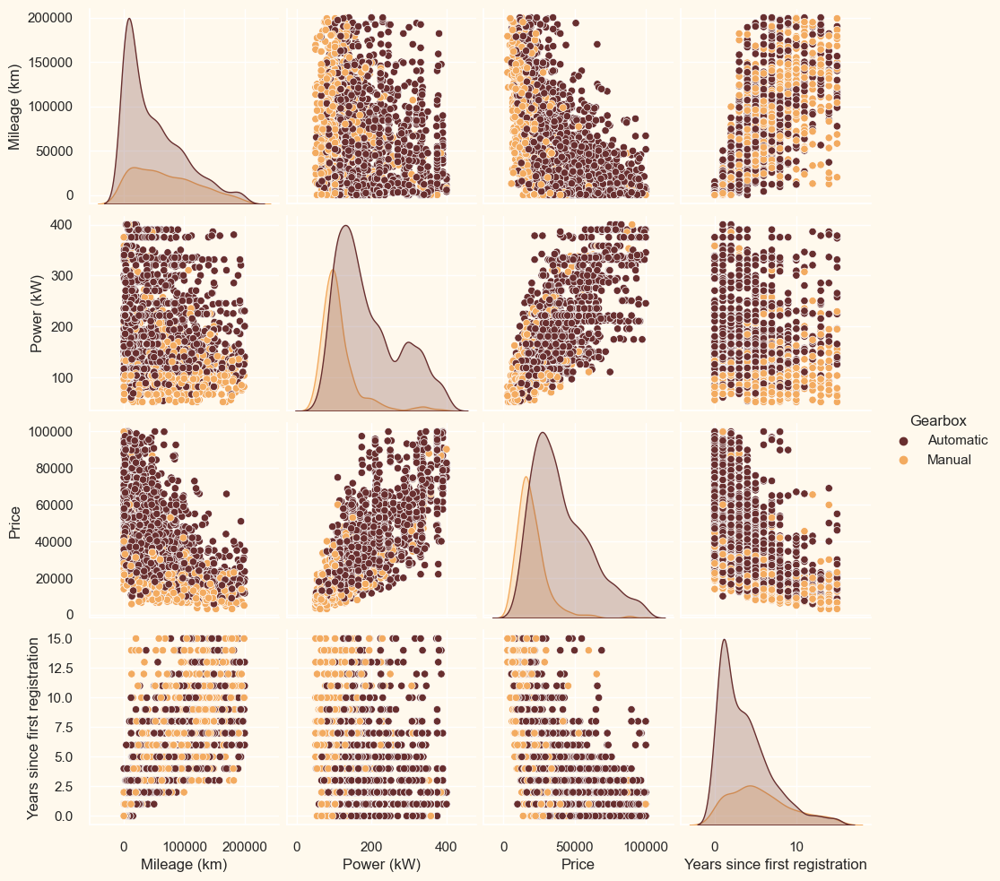

In [12]:
sns.set(rc={"axes.facecolor":"#FFF9ED","figure.facecolor":"#FFF9ED"})
pallet = ["#682F2F", "#9E726F", "#D6B2B1", "#B9C0C9", "#9F8A78", "#F3AB60"]
cmap = colors.ListedColormap(["#682F2F", "#9E726F", "#D6B2B1", "#B9C0C9", "#9F8A78", "#F3AB60"])
#Plotting following features
To_Plot = [ "Mileage (km)", "Gearbox", "Power (kW)", "Price", "Years since first registration",]
print("Relative Plot Of Some Selected Features: A Data Subset")
plt.figure()
sns.pairplot(data[To_Plot], hue= "Gearbox",palette= (["#682F2F","#F3AB60"]))
#Taking hue 
plt.show()

Same plot in simpler form

<Figure size 800x550 with 0 Axes>

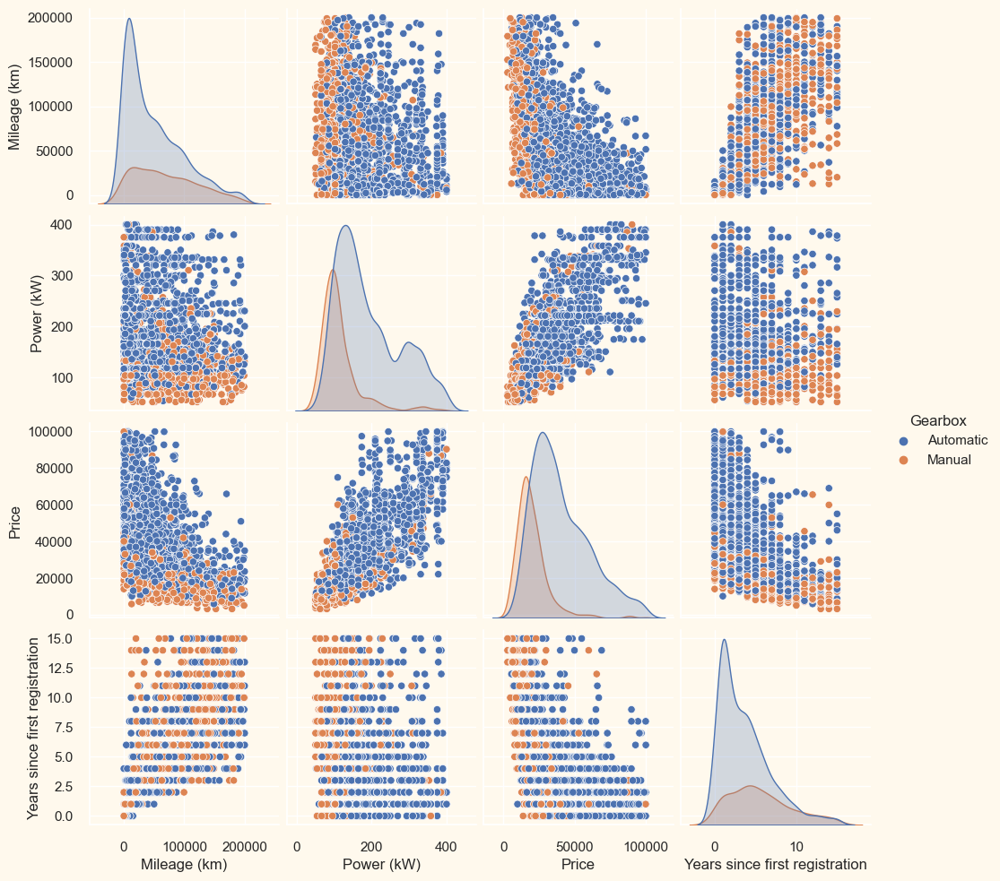

In [13]:
To_Plot = [ "Mileage (km)", "Gearbox", "Power (kW)", "Price", "Years since first registration",]
plt.figure()
sns.pairplot(data[To_Plot], hue= "Gearbox")
plt.show()

Relative Plot Of Some Selected Features: A Data Subset


<Figure size 800x550 with 0 Axes>

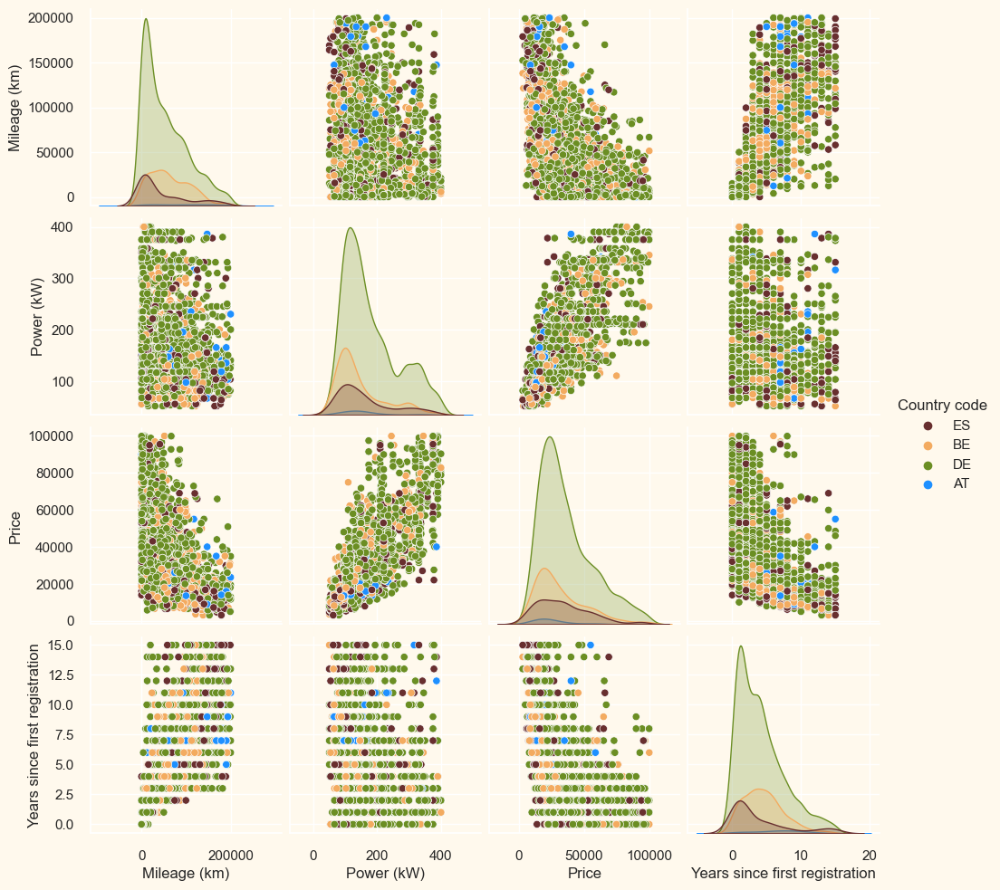

In [14]:
sns.set(rc={"axes.facecolor":"#FFF9ED","figure.facecolor":"#FFF9ED"})
pallet = ["#682F2F", "#9E726F", "#D6B2B1", "#B9C0C9", "#9F8A78", "#F3AB60", "#6B8E23", "#1E90FF"]
cmap = colors.ListedColormap(["#682F2F", "#9E726F", "#D6B2B1", "#B9C0C9", "#9F8A78", "#F3AB60", "#6B8E23", "#1E90FF"])
#Plotting following features
To_Plot = [ "Mileage (km)", "Country code", "Power (kW)", "Price","Years since first registration",]
print("Relative Plot Of Some Selected Features: A Data Subset")
plt.figure()
sns.pairplot(data[To_Plot], hue= "Country code",palette= (["#682F2F","#F3AB60", "#6B8E23", "#1E90FF"]))
#Taking hue 
plt.show()

<Figure size 800x550 with 0 Axes>

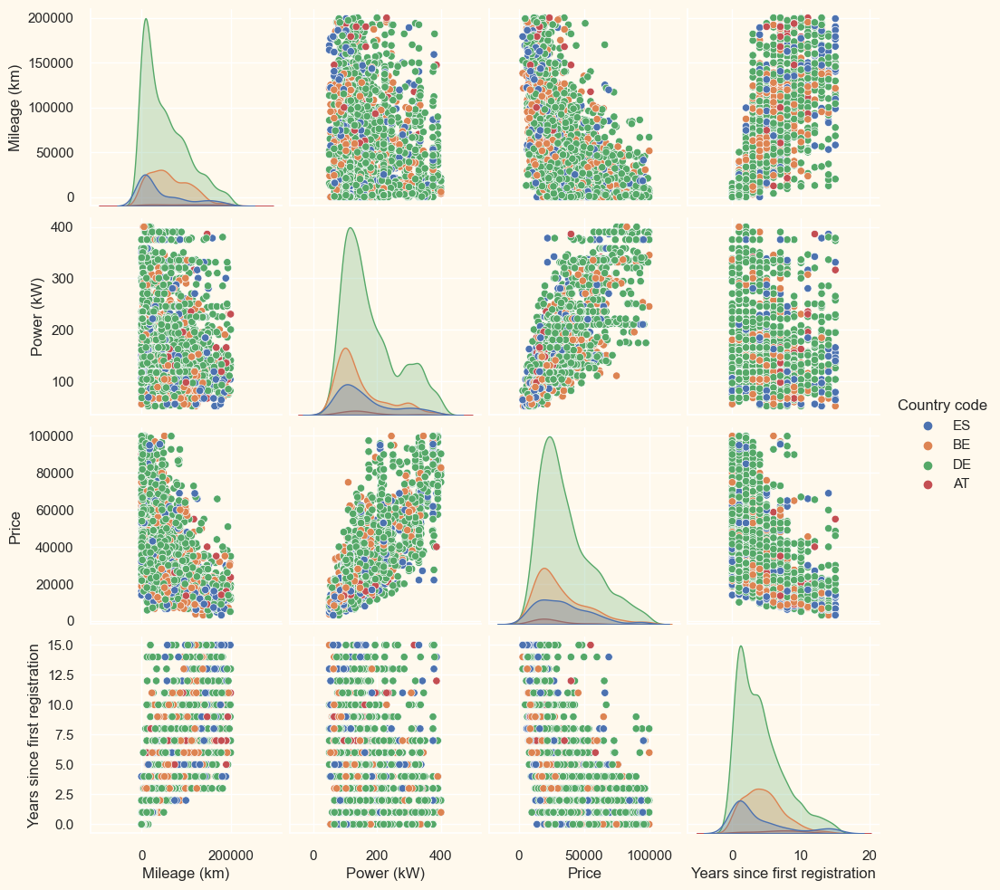

In [15]:
To_Plot = [ "Mileage (km)", "Country code", "Power (kW)", "Price", "Years since first registration",]
plt.figure()
sns.pairplot(data[To_Plot], hue= "Country code")
plt.show()

The correlation amongst the features (excluding the categorical attributes at this point)

<Axes: >

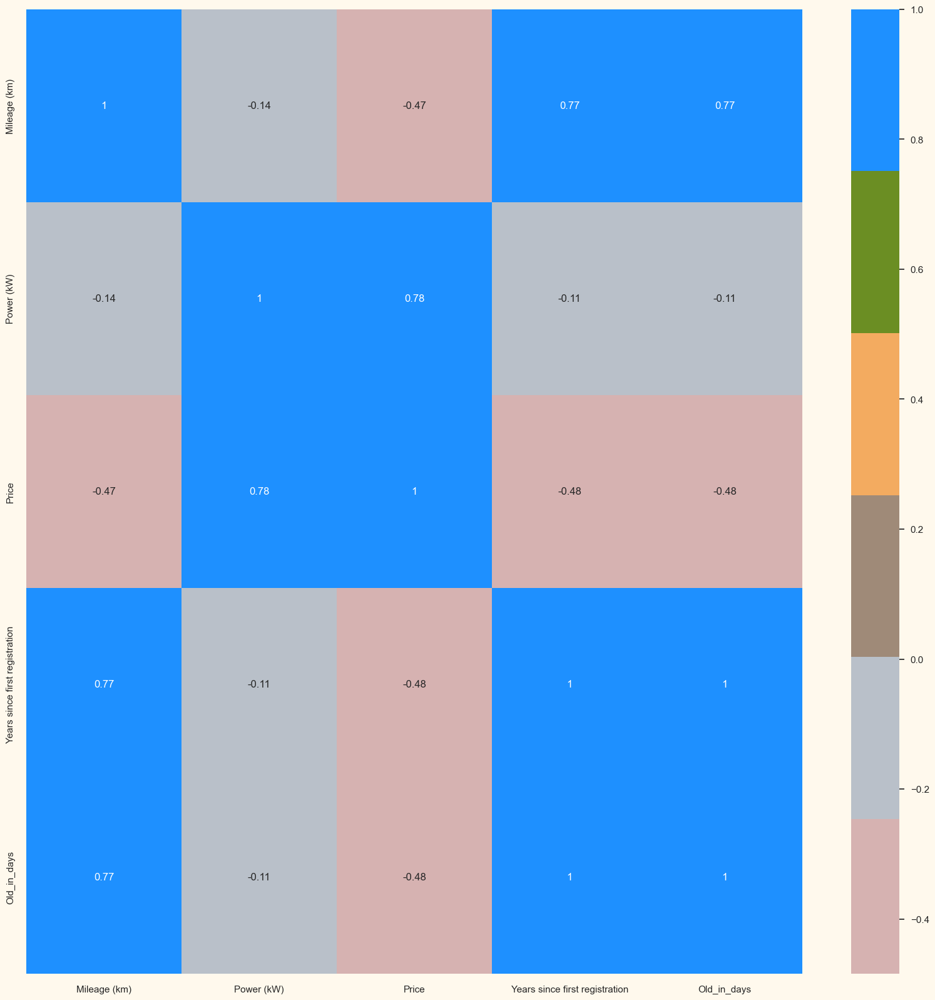

In [16]:
#correlation matrix
corrmat= data.corr()
plt.figure(figsize=(20,20))  
sns.heatmap(corrmat,annot=True, cmap=cmap, center=0)

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">DATA PREPROCESSING</p>

Data preprocessing in Jupyter Notebook refers to the steps taken to transform and prepare the data before performing any analysis or modeling. It involves converting categorical data (such as text or labels) into numerical format, scaling the numerical features to a consistent range, and reducing the dimensionality of the data.

Label encoding is a technique used to convert categorical data into numerical data. It assigns a unique numerical value to each category, allowing algorithms to process the data more effectively. The LabelEncoder class from the scikit-learn library is commonly used in Python to perform label encoding.

Scaling the features involves adjusting the numerical values of different features to a standardized range. This is done using techniques like standard scaling, which subtracts the mean and divides by the standard deviation, resulting in a mean of zero and a standard deviation of one. Scaling ensures that all features have a similar influence on the analysis, preventing any one feature from dominating the results.

Dimensionality reduction is the process of reducing the number of features in the dataset while preserving important information. This is done to simplify the dataset and eliminate irrelevant or redundant features. By creating a subset dataframe, the dimensionality of the data is reduced, making it more manageable for further analysis or modeling.

Overall, data preprocessing is an essential step in data analysis and machine learning tasks as it helps clean, transform, and prepare the data for meaningful insights and accurate modeling.








In [112]:
# Create a LabelEncoder instance
le = LabelEncoder()

# Fit the LabelEncoder to the Fuel type categorical variable
le.fit(data["Model"])

# Get the unique categories and their numerical values
categories = le.classes_
values = le.transform(categories)

# Print the mapping of categories to numerical values
print("Mapping of categories to numerical values for Model:")
for i in range(len(categories)):
    print(f"{categories[i]} -> {values[i]}")

Mapping of categories to numerical values for Model:
Audi A1 -> 0
Audi A3 -> 1
Audi A4 -> 2
Audi A4 allroad -> 3
Audi A5 -> 4
Audi A6 -> 5
Audi A6 allroad -> 6
Audi A7 -> 7
Audi A8 -> 8
Audi Allroad -> 9
Audi Q2 -> 10
Audi Q3 -> 11
Audi Q4 e-tron -> 12
Audi Q5 -> 13
Audi Q7 -> 14
Audi Q8 -> 15
Audi R8 -> 16
Audi RS Q3 -> 17
Audi RS3 -> 18
Audi RS4 -> 19
Audi RS5 -> 20
Audi S1 -> 21
Audi S3 -> 22
Audi S4 -> 23
Audi S5 -> 24
Audi S6 -> 25
Audi S8 -> 26
Audi SQ2 -> 27
Audi SQ5 -> 28
Audi SQ7 -> 29
Audi SQ8 -> 30
Audi TT -> 31
Audi TT RS -> 32
Audi TTS -> 33
Audi e-tron -> 34
Audi e-tron GT -> 35
BMW 114 -> 36
BMW 116 -> 37
BMW 118 -> 38
BMW 120 -> 39
BMW 128 -> 40
BMW 135 -> 41
BMW 140 -> 42
BMW 1er M Coupé -> 43
BMW 218 -> 44
BMW 220 -> 45
BMW 223 -> 46
BMW 228 -> 47
BMW 230 -> 48
BMW 235 -> 49
BMW 240 -> 50
BMW 316 -> 51
BMW 318 -> 52
BMW 320 -> 53
BMW 325 -> 54
BMW 328 -> 55
BMW 330 -> 56
BMW 335 -> 57
BMW 340 -> 58
BMW 420 -> 59
BMW 430 -> 60
BMW 435 -> 61
BMW 440 -> 62
BMW 518 -> 63


In [113]:
# Create a LabelEncoder instance
le = LabelEncoder()

# Fit the LabelEncoder to the Fuel type categorical variable
le.fit(data["Gearbox"])

# Get the unique categories and their numerical values
categories = le.classes_
values = le.transform(categories)

# Print the mapping of categories to numerical values
print("Mapping of categories to numerical values for Gearbox:")
for i in range(len(categories)):
    print(f"{categories[i]} -> {values[i]}")

Mapping of categories to numerical values for Gearbox:
Automatic -> 0
Manual -> 1


In [114]:
# Create a LabelEncoder instance
le = LabelEncoder()

# Fit the LabelEncoder to the Fuel type categorical variable
le.fit(data["Fuel type"])

# Get the unique categories and their numerical values
categories = le.classes_
values = le.transform(categories)

# Print the mapping of categories to numerical values
print("Mapping of categories to numerical values for Fuel type:")
for i in range(len(categories)):
    print(f"{categories[i]} -> {values[i]}")

Mapping of categories to numerical values for Fuel type:
CNG -> 0
Diesel -> 1
Electric -> 2
Electric/Diesel -> 3
Electric/Gasoline -> 4
Gasoline -> 5
LPG -> 6
Others -> 7


In [115]:
# Create a LabelEncoder instance
le = LabelEncoder()

# Fit the LabelEncoder to the Fuel type categorical variable
le.fit(data["Country code"])

# Get the unique categories and their numerical values
categories = le.classes_
values = le.transform(categories)

# Print the mapping of categories to numerical values
print("Mapping of categories to numerical values for Country code:")
for i in range(len(categories)):
    print(f"{categories[i]} -> {values[i]}")

Mapping of categories to numerical values for Country code:
AT -> 0
BE -> 1
DE -> 2
ES -> 3


In [116]:
from sklearn.preprocessing import LabelEncoder

# Creating an example categorical feature
categories = ['Red', 'Green', 'Blue', 'Red', 'Green', 'Green']

# Creating an instance of the LabelEncoder
le = LabelEncoder()

# Fitting and transforming the categorical feature using the LabelEncoder
encoded_categories = le.fit_transform(categories)

print(encoded_categories)

[2 1 0 2 1 1]


Scaling the features is a common preprocessing step in machine learning that helps to standardize the range of the features. The StandardScaler class from the scikit-learn library can be used to scale the features using the standard scaler. 

In [117]:
from sklearn.preprocessing import StandardScaler
import numpy as np

# Creating an example dataset with two features
X = np.array([[10, 20], [30, 40], [50, 60]])
X

array([[10, 20],
       [30, 40],
       [50, 60]])

In [118]:
# Creating an instance of the StandardScaler
scaler = StandardScaler()

# Fitting and transforming the dataset using the StandardScaler
X_scaled = scaler.fit_transform(X)

print(X_scaled)

[[-1.22474487 -1.22474487]
 [ 0.          0.        ]
 [ 1.22474487  1.22474487]]


In [119]:
#Get list of categorical variables
s = (data.dtypes == 'object')
object_cols = list(s[s].index)

print("Categorical variables in the dataset:", object_cols)

Categorical variables in the dataset: ['Model', 'Gearbox', 'First registration', 'Fuel type', 'Country code']


In [120]:
print("Total categories in the feature Model:\n", data["Model"].value_counts())

Total categories in the feature Model:
 Volvo XC60                    80
Volkswagen Golf               75
Skoda Octavia                 67
Volvo XC90                    63
Opel Astra                    61
Renault Megane                58
Ford Mustang                  55
Opel Grandland X              54
Volvo XC40                    44
Renault Captur                42
Volvo V60                     41
Skoda Kodiaq                  41
Skoda Superb                  40
Opel Corsa                    40
Ford Mustang Mach-E           39
Skoda Karoq                   39
Renault Clio                  37
Ford Kuga                     34
Opel Insignia                 34
Opel Crossland                33
Volkswagen T-Roc              31
Ford Focus                    30
Opel Crossland X              28
Skoda Scala                   27
Volvo C40                     27
Ford Fiesta                   25
Audi A5                       24
Volvo S60                     24
Volvo S90                     23
Sko

In [121]:
print("Total categories in the feature Gearbox:\n", data["Gearbox"].value_counts())

Total categories in the feature Gearbox:
 Automatic    1908
Manual        689
Name: Gearbox, dtype: int64


In [122]:
print("Total categories in the feature First registration:\n", data["First registration"].value_counts())

Total categories in the feature First registration:
 2022-12-01    74
2023-03-01    58
2022-10-01    56
2022-07-01    52
2022-11-01    51
2022-06-01    50
2023-04-01    50
2022-09-01    50
2022-05-01    45
2019-01-01    45
2022-03-01    44
2022-04-01    44
2023-01-01    42
2021-03-01    40
2020-01-01    40
2020-02-01    39
2020-03-01    37
2019-04-01    35
2020-12-01    35
2023-02-01    34
2021-12-01    33
2022-08-01    32
2021-01-01    31
2018-03-01    31
2019-02-01    31
2021-02-01    30
2022-01-01    29
2018-01-01    28
2019-06-01    28
2021-08-01    28
2022-02-01    25
2020-07-01    25
2019-11-01    25
2018-02-01    24
2019-03-01    24
2019-07-01    23
2021-07-01    23
2020-11-01    22
2019-09-01    22
2017-01-01    22
2021-10-01    21
2018-04-01    21
2018-11-01    21
2017-03-01    20
2018-07-01    20
2021-05-01    20
2019-08-01    20
2018-08-01    19
2019-12-01    19
2020-10-01    19
2017-10-01    19
2018-06-01    19
2017-07-01    19
2019-10-01    19
2020-06-01    18
2017-04-01  

In [123]:
print("Total categories in the feature Fuel type:\n", data["Fuel type"].value_counts())

Total categories in the feature Fuel type:
 Gasoline             1330
Diesel                752
Electric/Gasoline     263
Electric              237
Others                  6
Electric/Diesel         5
CNG                     3
LPG                     1
Name: Fuel type, dtype: int64


In [124]:
print("Total categories in the feature Power (kW):\n", data["Power (kW)"].value_counts())

Total categories in the feature Power (kW):
 110    214
96     130
140    126
103     91
81      65
100     64
180     58
300     53
85      51
150     51
288     50
165     46
135     46
147     46
331     46
125     44
221     38
335     36
132     35
375     34
145     33
130     32
235     32
74      30
390     29
66      28
210     28
88      27
118     25
173     24
220     24
184     24
120     24
92      23
195     22
206     22
155     21
170     19
160     19
190     19
176     19
338     18
250     17
116     17
117     17
358     17
320     17
162     16
294     16
107     16
245     16
200     15
67      15
225     15
77      15
287     14
270     14
55      14
169     14
185     14
330     14
70      14
198     12
51      11
154     11
136     11
75      10
90      10
258     10
133     10
310      9
230      9
223      9
400      9
105      9
134      9
80       8
228      8
215      8
275      8
224      8
350      7
280      7
251      7
336      7
115      6
213      

In [125]:
print("Total categories in the feature Country code:\n", data["Country code"].value_counts())

Total categories in the feature Country code:
 DE    1763
BE     497
ES     296
AT      41
Name: Country code, dtype: int64


In [126]:
print("Total categories in the feature Years since first registration:\n", data["Years since first registration"].value_counts())

Total categories in the feature Years since first registration:
 1     552
4     308
2     284
3     275
5     241
6     190
0     185
7     140
8     113
9      76
10     66
11     39
12     38
13     33
14     30
15     27
Name: Years since first registration, dtype: int64


In [127]:
#Label Encoding the object dtypes.
LE=LabelEncoder()
for i in object_cols:
    data[i]=data[[i]].apply(LE.fit_transform)
    
print("All features are now numerical")

All features are now numerical


LabelEncoder() is a class from the scikit-learn library in Python that is used to perform label encoding on categorical data. Label encoding is a process of converting categorical data into numerical data.

The LabelEncoder() class has two main methods: fit() and transform().

The fit() method takes a list or array of categorical data as input and learns the mapping between the categories and the numerical labels. The mapping is stored in the classes_ attribute of the LabelEncoder object.

The transform() method takes a list or array of categorical data as input and uses the learned mapping to convert the categories into numerical labels. The output is a new array of numerical labels that can be used for machine learning algorithms that require numerical data.

In [128]:
data

,Model,Mileage (km),Gearbox,First registration,Fuel type,Power (kW),Price,Country code,Years since first registration
0,310,6,0,172,2,300,48800,3,1
1,322,1,0,132,5,184,36500,3,4
2,310,1990,0,168,2,300,51600,3,1
3,310,8915,0,167,2,300,61990,1,1
4,312,147300,0,29,5,243,19980,2,13
5,310,3500,0,175,2,300,59990,2,1
6,322,127000,0,123,4,300,29990,3,5
7,322,150000,0,101,1,140,18985,2,7
8,322,146000,0,57,1,120,15985,2,10
9,321,1180,0,176,2,300,54500,3,1


In [129]:
for i in object_cols:
    le = LabelEncoder()
    data[i] = le.fit_transform(data[i])
    print(f"Mapping for {i}: {dict(zip(le.classes_, le.transform(le.classes_)))}")
    
print("All features are now numerical")

Mapping for Model: {0: 0, 1: 1, 2: 2, 3: 3, 4: 4, 5: 5, 6: 6, 7: 7, 8: 8, 9: 9, 10: 10, 11: 11, 12: 12, 13: 13, 14: 14, 15: 15, 16: 16, 17: 17, 18: 18, 19: 19, 20: 20, 21: 21, 22: 22, 23: 23, 24: 24, 25: 25, 26: 26, 27: 27, 28: 28, 29: 29, 30: 30, 31: 31, 32: 32, 33: 33, 34: 34, 35: 35, 36: 36, 37: 37, 38: 38, 39: 39, 40: 40, 41: 41, 42: 42, 43: 43, 44: 44, 45: 45, 46: 46, 47: 47, 48: 48, 49: 49, 50: 50, 51: 51, 52: 52, 53: 53, 54: 54, 55: 55, 56: 56, 57: 57, 58: 58, 59: 59, 60: 60, 61: 61, 62: 62, 63: 63, 64: 64, 65: 65, 66: 66, 67: 67, 68: 68, 69: 69, 70: 70, 71: 71, 72: 72, 73: 73, 74: 74, 75: 75, 76: 76, 77: 77, 78: 78, 79: 79, 80: 80, 81: 81, 82: 82, 83: 83, 84: 84, 85: 85, 86: 86, 87: 87, 88: 88, 89: 89, 90: 90, 91: 91, 92: 92, 93: 93, 94: 94, 95: 95, 96: 96, 97: 97, 98: 98, 99: 99, 100: 100, 101: 101, 102: 102, 103: 103, 104: 104, 105: 105, 106: 106, 107: 107, 108: 108, 109: 109, 110: 110, 111: 111, 112: 112, 113: 113, 114: 114, 115: 115, 116: 116, 117: 117, 118: 118, 119: 119, 

In [130]:
print("Unique values for Model:", data["Model"].unique())
print("Unique values for Gearbox:", data["Gearbox"].unique())
print("Unique values for Fuel type:", data["Fuel type"].unique())
print("Unique values for Country code:", data["Country code"].unique())

Unique values for Model: [310 322 312 321 316 324 315 313 314 317 318 309 319 320 323 311 256 259
 254 255 251 252 253 260 258 257   2   5  16  12   4   1  20  27  21  22
  32  18  17  34  13  33  14  23   7  24  31  35  25  11   3  10   0   8
  26  30  19  28  29   9  15   6  71  64  81  51  98  80  75  77  91  96
  53  79  56  69  90  59  41  49  74  58  93  87  84  43  60  61  97  65
  39  66  92  47  88  62  70  48  57  54  50  85  99  36  82  76  83  38
  37  63  52  94  44  89  73  72  67  95  68  46  86 100  40  45  78 101
  55  42 115 116 108 107 105 119 120 114 106 122 113 111 117 110 121 124
 102 103 118 125 104 109 112 123 191 159 144 186 156 132 179 161 149 131
 146 166 170 152 138 193 155 139 160 163 135 162 143 171 187 168 137 195
 174 142 167 141 140 154 165 194 199 134 158 153 126 164 185 182 196 130
 188 145 129 136 200 181 197 173 192 183 198 169 178 147 189 151 148 176
 190 172 157 150 128 184 177 180 175 133 127 217 204 214 215 208 210 223
 220 216 211 212 218 213 2

In [131]:
from sklearn.preprocessing import LabelEncoder

# Create a list of categorical data
dataSample = ['apple', 'banana', 'orange', 'banana', 'apple', 'orange']

# Create an instance of the LabelEncoder
le = LabelEncoder()

# Fit and transform the data using the LabelEncoder
encoded_data = le.fit_transform(dataSample)

# Print the encoded data
print(encoded_data)

[0 1 2 1 0 2]


In [132]:
# create a copy of data
ds = data.copy()

# create a subset of dataframe by dropping the 'Country code' feature
cols_del = ['First registration']
ds = ds.drop(cols_del, axis=1)

# scaling the features
scaler = StandardScaler()
scaler.fit(ds)
scaled_ds = pd.DataFrame(scaler.transform(ds), columns=ds.columns)
print("All features are now scaled")

All features are now scaled


In [133]:
#Scaled data to be used for reducing the dimensionality
print("Dataframe to be used for further modelling:")
scaled_ds.head()

Dataframe to be used for further modelling:


,Model,Mileage (km),Gearbox,Fuel type,Power (kW),Price,Country code,Years since first registration
0,1.181566,-1.087768,-0.600925,-0.812685,1.514358,0.675193,1.857006,-0.926089
1,1.309177,-1.087866,-0.600925,0.854850,0.153000,0.072884,1.857006,-0.055954
2,1.181566,-1.048674,-0.600925,-0.812685,1.514358,0.812305,1.857006,-0.926089
3,1.181566,-0.912219,-0.600925,-0.812685,1.514358,1.321085,-1.492053,-0.926089
4,1.202835,1.814607,-0.600925,0.854850,0.845415,-0.736072,0.182477,2.554450


<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">EXPLORING CONVERTED DATA</p>

After converting the categorical variables into numerical ones, I made an brief exploration of the converted data.

In [134]:
# Encode the Model variable
le = LabelEncoder()
data["Model"] = le.fit_transform(data["Model"])

# Calculate the percentage of each category
counts = data["Model"].value_counts()
percentages = counts / counts.sum() * 100

# Print the percentages
print("Percentage of each numerical category in Model:")
print(percentages)


Percentage of each numerical category in Model:
322    3.080477
268    2.887948
256    2.579900
324    2.425876
204    2.348864
243    2.233346
115    2.117828
214    2.079322
321    1.694263
231    1.617251
316    1.578745
255    1.578745
259    1.540239
208    1.540239
116    1.501733
254    1.501733
232    1.424721
113    1.309203
215    1.309203
210    1.270697
291    1.193685
108    1.155179
211    1.078167
258    1.039661
310    1.039661
107    0.962649
4      0.924143
312    0.924143
314    0.885637
253    0.885637
238    0.885637
319    0.847131
114    0.808625
81     0.808625
230    0.770119
251    0.770119
5      0.770119
304    0.731613
2      0.693107
217    0.693107
1      0.693107
245    0.654601
302    0.654601
213    0.577590
246    0.577590
282    0.539084
219    0.539084
247    0.539084
315    0.539084
250    0.500578
207    0.500578
263    0.500578
218    0.500578
20     0.462072
229    0.462072
53     0.462072
303    0.462072
122    0.462072
98     0.462072
233    0

In [135]:
# Encode the Gearbox variable
le = LabelEncoder()
data["Gearbox"] = le.fit_transform(data["Gearbox"])

# Calculate the percentage of each category
counts = data["Gearbox"].value_counts()
percentages = counts / counts.sum() * 100

# Print the percentages
print("Percentage of each numerical category in Gearbox:")
print(percentages)


Percentage of each numerical category in Gearbox:
0    73.469388
1    26.530612
Name: Gearbox, dtype: float64


<Axes: >

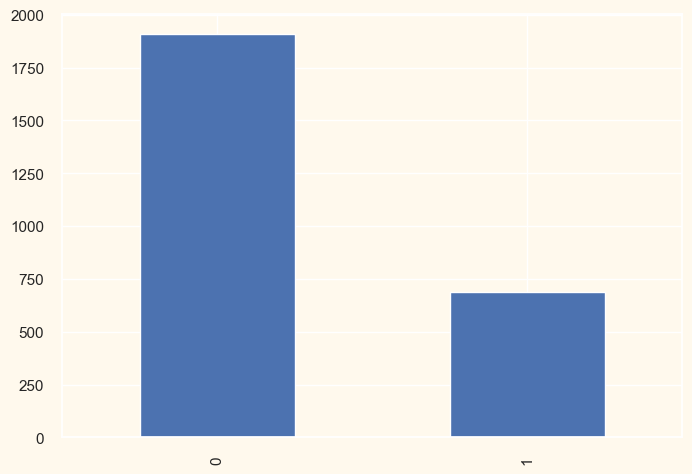

In [136]:
data["Gearbox"].value_counts().plot(kind="bar")

<Axes: xlabel='Gearbox', ylabel='Density'>

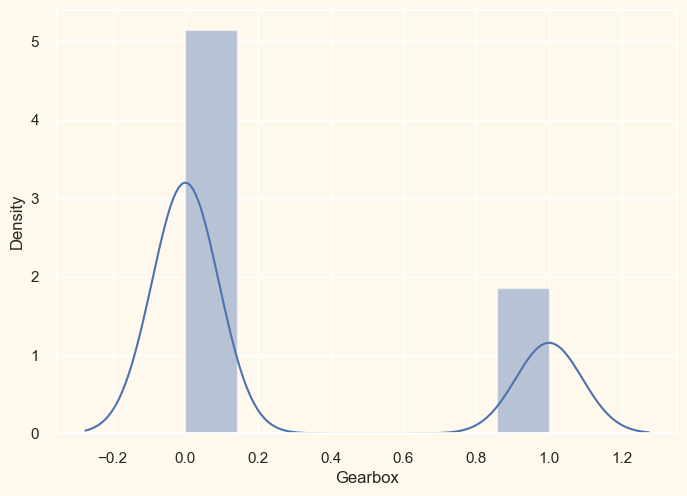

In [137]:
sns.distplot(data['Gearbox'])

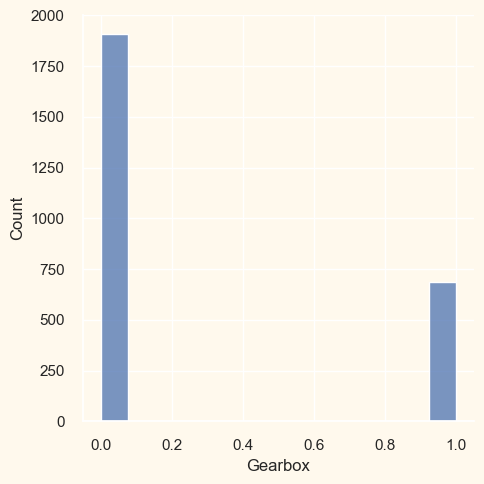

In [138]:
sns.displot(data['Gearbox'])

In [139]:
# Encode the Fuel type variable
le = LabelEncoder()
data["Fuel type"] = le.fit_transform(data["Fuel type"])

# Calculate the percentage of each category
counts = data["Fuel type"].value_counts()
percentages = counts / counts.sum() * 100

# Print the percentages
print("Percentage of each numerical category in Fuel type:")
print(percentages)

Percentage of each numerical category in Fuel type:
5    51.212938
1    28.956488
4    10.127070
2     9.125915
7     0.231036
3     0.192530
0     0.115518
6     0.038506
Name: Fuel type, dtype: float64


<Axes: >

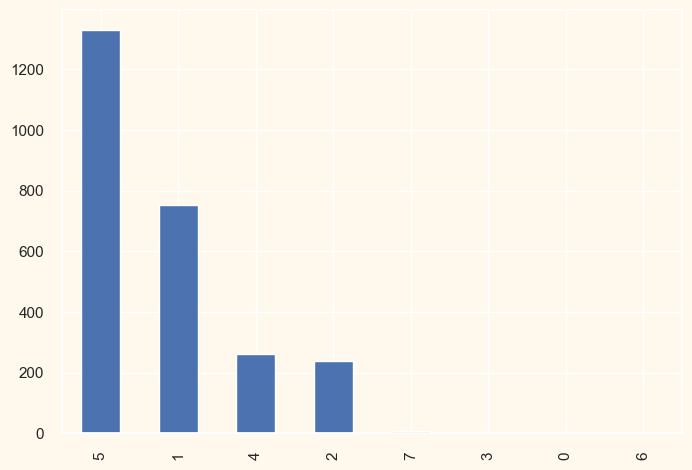

In [140]:
# Plot a bar chart of the counts of each category
data["Fuel type"].value_counts().plot(kind="bar")

<Axes: xlabel='Fuel type', ylabel='Density'>

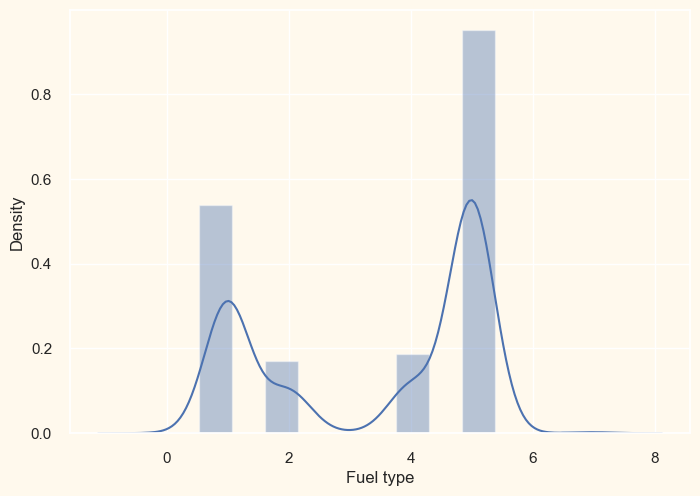

In [141]:
sns.distplot(data['Fuel type'])

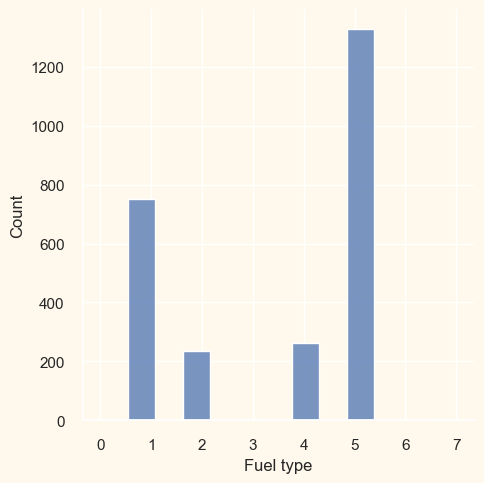

In [142]:
sns.displot(data['Fuel type'])

In [143]:
# Encode the Country code variable
le = LabelEncoder()
data["Country code"] = le.fit_transform(data["Country code"])

# Calculate the percentage of each category
counts = data["Country code"].value_counts()
percentages = counts / counts.sum() * 100

# Print the percentages
print("Percentage of each numerical category in Country code:")
print(percentages)

Percentage of each numerical category in Country code:
2    67.886022
1    19.137466
3    11.397767
0     1.578745
Name: Country code, dtype: float64


<Axes: >

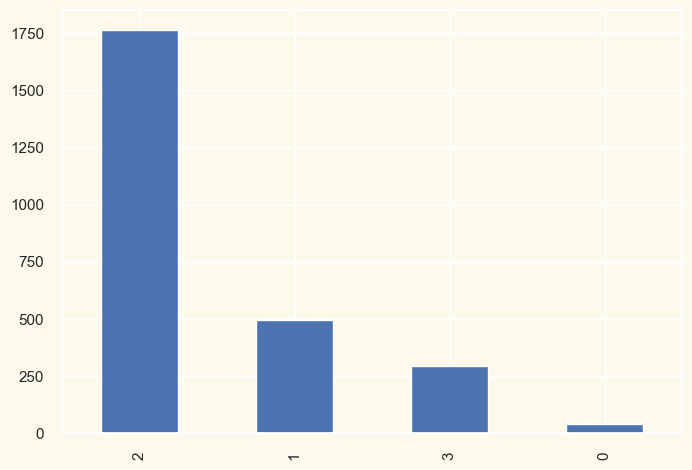

In [144]:
# Plot a bar chart of the counts of each category
data["Country code"].value_counts().plot(kind="bar")

<Axes: xlabel='Country code', ylabel='Density'>

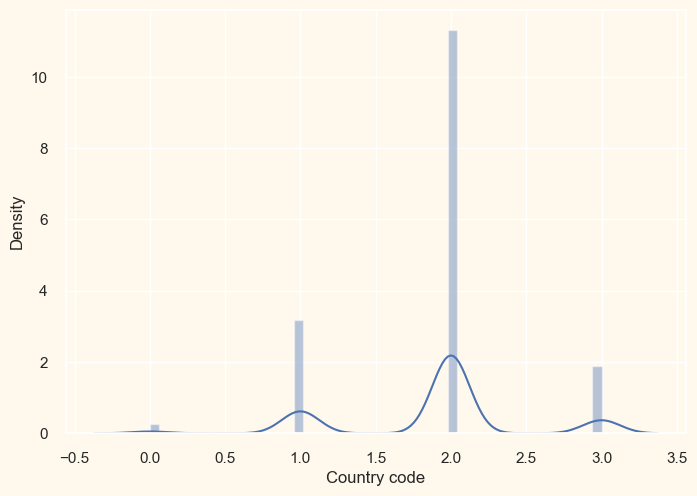

In [145]:
sns.distplot(data['Country code'])

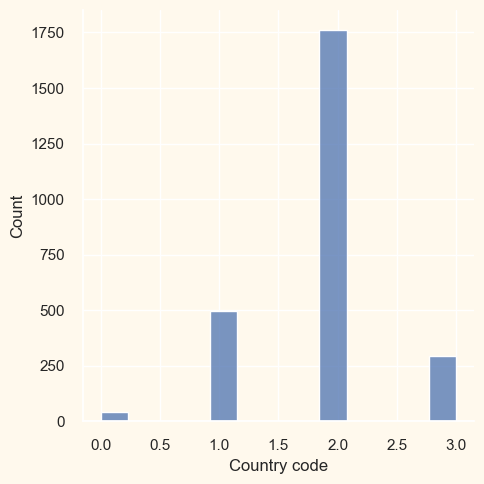

In [146]:
sns.displot(data['Country code'])

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">DIMENSIONALITY REDUCTION</p>

In this problem, there are many factors on the basis of which the final classification will be done. These factors are basically attributes or features. The higher the number of features, the harder it is to work with it. Many of these features are correlated, and hence redundant. This is why I will be performing dimensionality reduction on the selected features before putting them through a classifier.
Dimensionality reduction is the process of reducing the number of random variables under consideration, by obtaining a set of principal variables.

Principal component analysis (PCA) is a technique for reducing the dimensionality of such datasets, increasing interpretability but at the same time minimizing information loss.

Steps in this section:

Dimensionality reduction with PCA
Plotting the reduced dataframe
Dimensionality reduction with PCA

For this project, I will be reducing the dimensions to 3.

Principal Component Analysis (PCA) is a technique used for dimensionality reduction and feature extraction in machine learning. PCA can be used to reduce the number of dimensions in a dataset while retaining as much of the original variance as possible. In Python, you can use the PCA class from the scikit-learn library to perform PCA. Here is an example of how to use PCA in Python:

In [147]:
from sklearn.decomposition import PCA
from sklearn.datasets import load_iris
import matplotlib.pyplot as plt

# Load the iris dataset
# https://archive.ics.uci.edu/ml/datasets/iris
iris = load_iris()
X = iris.data
print(X)
y = iris.target
print(y)

[[5.1 3.5 1.4 0.2]
 [4.9 3.  1.4 0.2]
 [4.7 3.2 1.3 0.2]
 [4.6 3.1 1.5 0.2]
 [5.  3.6 1.4 0.2]
 [5.4 3.9 1.7 0.4]
 [4.6 3.4 1.4 0.3]
 [5.  3.4 1.5 0.2]
 [4.4 2.9 1.4 0.2]
 [4.9 3.1 1.5 0.1]
 [5.4 3.7 1.5 0.2]
 [4.8 3.4 1.6 0.2]
 [4.8 3.  1.4 0.1]
 [4.3 3.  1.1 0.1]
 [5.8 4.  1.2 0.2]
 [5.7 4.4 1.5 0.4]
 [5.4 3.9 1.3 0.4]
 [5.1 3.5 1.4 0.3]
 [5.7 3.8 1.7 0.3]
 [5.1 3.8 1.5 0.3]
 [5.4 3.4 1.7 0.2]
 [5.1 3.7 1.5 0.4]
 [4.6 3.6 1.  0.2]
 [5.1 3.3 1.7 0.5]
 [4.8 3.4 1.9 0.2]
 [5.  3.  1.6 0.2]
 [5.  3.4 1.6 0.4]
 [5.2 3.5 1.5 0.2]
 [5.2 3.4 1.4 0.2]
 [4.7 3.2 1.6 0.2]
 [4.8 3.1 1.6 0.2]
 [5.4 3.4 1.5 0.4]
 [5.2 4.1 1.5 0.1]
 [5.5 4.2 1.4 0.2]
 [4.9 3.1 1.5 0.2]
 [5.  3.2 1.2 0.2]
 [5.5 3.5 1.3 0.2]
 [4.9 3.6 1.4 0.1]
 [4.4 3.  1.3 0.2]
 [5.1 3.4 1.5 0.2]
 [5.  3.5 1.3 0.3]
 [4.5 2.3 1.3 0.3]
 [4.4 3.2 1.3 0.2]
 [5.  3.5 1.6 0.6]
 [5.1 3.8 1.9 0.4]
 [4.8 3.  1.4 0.3]
 [5.1 3.8 1.6 0.2]
 [4.6 3.2 1.4 0.2]
 [5.3 3.7 1.5 0.2]
 [5.  3.3 1.4 0.2]
 [7.  3.2 4.7 1.4]
 [6.4 3.2 4.5 1.5]
 [6.9 3.1 4.

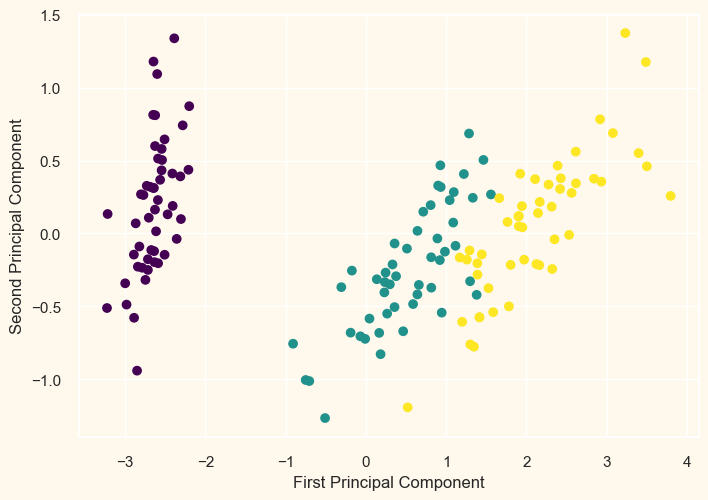

In [148]:
# Perform PCA on the dataset
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)

# Plot the results
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=y, cmap='viridis')
plt.xlabel('First Principal Component')
plt.ylabel('Second Principal Component')
plt.show()

In [149]:
#Initiating PCA to reduce dimentions aka features to 3
pca = PCA(n_components=3)
pca.fit(scaled_ds)
PCA_ds = pd.DataFrame(pca.transform(scaled_ds), columns=(["col1","col2", "col3"]))
PCA_ds.describe().T

,count,mean,std,min,25%,50%,75%,max
col1,2597.0,0.000000e+00,1.646116,-4.024809,-1.149148,-0.038933,1.207632,4.406304
col2,2597.0,-6.566433e-17,1.231405,-2.683621,-0.938659,-0.215399,0.853390,4.506165
col3,2597.0,6.019230e-17,1.062351,-2.755364,-0.770676,0.054453,0.736751,2.964639


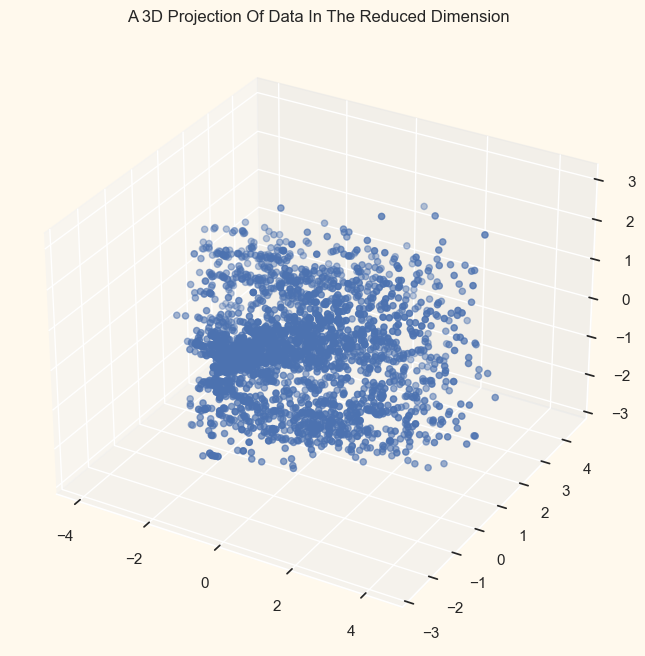

In [150]:
#A 3D Projection Of Data In The Reduced Dimension
x =PCA_ds["col1"]
y =PCA_ds["col2"]
z =PCA_ds["col3"]
#To plot
fig = plt.figure(figsize=(10,8))
ax = fig.add_subplot(111, projection="3d")
ax.scatter(x,y,z, marker="o" )
ax.set_title("A 3D Projection Of Data In The Reduced Dimension")
plt.show()

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">CLUSTERING</p>

After reducing the attributes to three dimensions, I will perform clustering using a method called Agglomerative clustering. This method merges examples together until the desired number of clusters is reached.

Here are the steps involved in the clustering process:

Elbow Method: To determine the number of clusters, we use the elbow method. It plots the within-cluster sum of squares (WCSS) against the number of clusters and looks for a point where the rate of decrease in WCSS slows down, forming an "elbow" shape.

Clustering: We apply Agglomerative Clustering, which is a hierarchical clustering technique, to group the data into clusters based on similarity.

Examining the Clusters: We visualize the clusters formed using a scatter plot, which helps us understand the patterns and relationships between the data points within each cluster.

The elbow method helps us decide the optimal number of clusters by identifying the point on the plot where the decrease in WCSS levels off. However, it's important to note that the elbow method may not always provide a clear elbow point. In such cases, alternative methods like the silhouette method or gap statistic can be used to determine the optimal number of clusters.








In [151]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# Generate random data
X = np.random.rand(100, 2)
X

array([[0.9429097 , 0.32320293],
       [0.51879062, 0.70301896],
       [0.3636296 , 0.97178208],
       [0.96244729, 0.2517823 ],
       [0.49724851, 0.30087831],
       [0.28484049, 0.03688695],
       [0.60956433, 0.50267902],
       [0.05147875, 0.27864646],
       [0.90826589, 0.23956189],
       [0.14489487, 0.48945276],
       [0.98565045, 0.24205527],
       [0.67213555, 0.76161962],
       [0.23763754, 0.72821635],
       [0.36778313, 0.63230583],
       [0.63352971, 0.53577468],
       [0.09028977, 0.8353025 ],
       [0.32078006, 0.18651851],
       [0.04077514, 0.59089294],
       [0.67756436, 0.01658783],
       [0.51209306, 0.22649578],
       [0.64517279, 0.17436643],
       [0.69093774, 0.38673535],
       [0.93672999, 0.13752094],
       [0.34106635, 0.11347352],
       [0.92469362, 0.87733935],
       [0.25794163, 0.65998405],
       [0.8172222 , 0.55520081],
       [0.52965058, 0.24185229],
       [0.09310277, 0.89721576],
       [0.90041806, 0.63310146],
       [0.

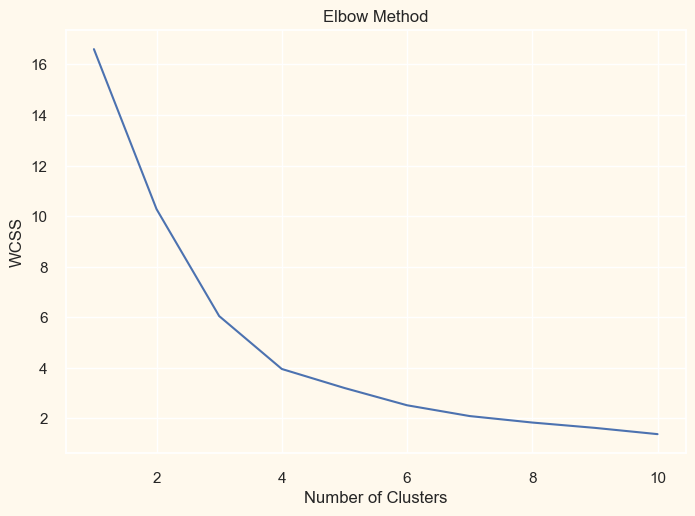

In [152]:
# Create a list to store WCSS values for each k
wcss = []

# Iterate over a range of k values
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, init='k-means++', max_iter=300, n_init=10, random_state=0)
    kmeans.fit(X)
    wcss.append(kmeans.inertia_)

# Plot the elbow curve
plt.plot(range(1, 11), wcss)
plt.title('Elbow Method')
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.show()

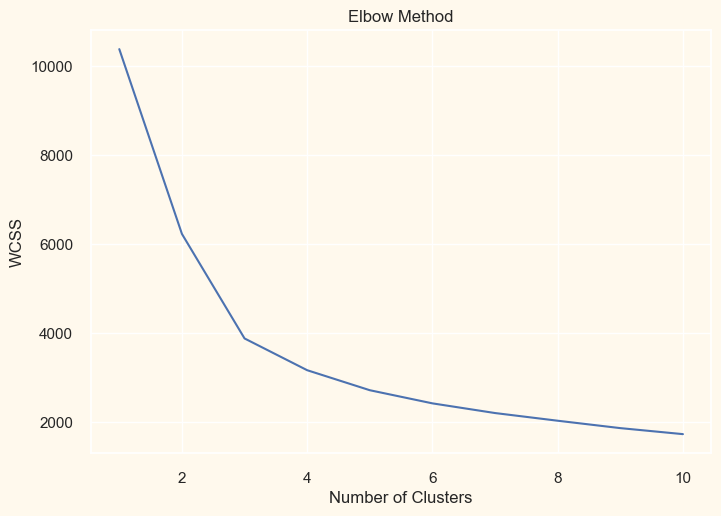

In [153]:
# Import required libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

# Load data into a dataframe
df = pd.read_csv('C:/Users/Ivan/Desktop/my_First_Python_Project/data/raw/autoscout24.analysis.csv')

# Extract the columns that you want to use for clustering
X = df[['Mileage (km)', 'Power (kW)', 'Price', 'Years since first registration']]

# Scale the data
scaler = StandardScaler()
scaled_data = scaler.fit_transform(X)

# Create a list to store WCSS values for each k
wcss = []

# Iterate over a range of k values
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, init='k-means++', max_iter=300, n_init=10, random_state=0)
    kmeans.fit(scaled_data)
    wcss.append(kmeans.inertia_)

# Plot the elbow curve
plt.plot(range(1, 11), wcss)
plt.title('Elbow Method')
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.show()

From the plot, it appears that the elbow point is around 3 clusters. 
Therefore, it can be concluded that the optimal number of clusters in this example is 3. However, the elbow method is not always definitive and may not always yield a clear elbow point, so it should also consider other methods for determining the optimal number of clusters.

Elbow Method to determine the number of clusters to be formed:


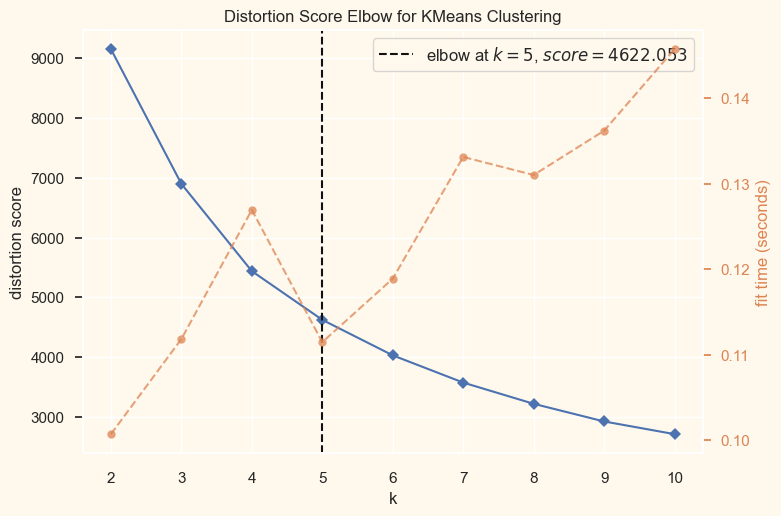

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [154]:
# Quick examination of elbow method to find numbers of clusters to make.
print('Elbow Method to determine the number of clusters to be formed:')
Elbow_M = KElbowVisualizer(KMeans(), k=10)
Elbow_M.fit(PCA_ds)
Elbow_M.show()

The above cell indicates that 5 will be an optimal number of clusters for this data. Next is fitting the Agglomerative Clustering Model to get the final clusters.

In [155]:
#Initiating the Agglomerative Clustering model 
AC = AgglomerativeClustering(n_clusters=5)
# fit model and predict clusters
yhat_AC = AC.fit_predict(PCA_ds)
PCA_ds["Clusters"] = yhat_AC
#Adding the Clusters feature to the orignal dataframe.
data["Clusters"]= yhat_AC

In [156]:
data

,Model,Mileage (km),Gearbox,First registration,Fuel type,Power (kW),Price,Country code,Years since first registration,Clusters
0,310,6,0,172,2,300,48800,3,1,3
1,322,1,0,132,5,184,36500,3,4,3
2,310,1990,0,168,2,300,51600,3,1,3
3,310,8915,0,167,2,300,61990,1,1,3
4,312,147300,0,29,5,243,19980,2,13,2
5,310,3500,0,175,2,300,59990,2,1,3
6,322,127000,0,123,4,300,29990,3,5,4
7,322,150000,0,101,1,140,18985,2,7,4
8,322,146000,0,57,1,120,15985,2,10,4
9,321,1180,0,176,2,300,54500,3,1,3


Examining the clusters formed with the 3-D distribution of the clusters.

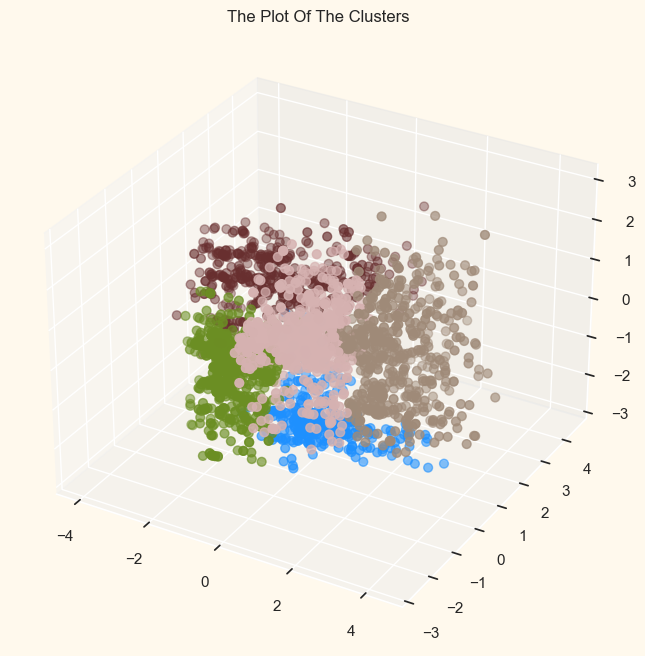

In [157]:
#Plotting the clusters
fig = plt.figure(figsize=(10,8))
ax = plt.subplot(111, projection='3d', label="bla")
ax.scatter(x, y, z, s=40, c=PCA_ds["Clusters"], marker='o', cmap = cmap )
ax.set_title("The Plot Of The Clusters")
plt.show()

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">EVALUATING MODELS</p>

Since this is an unsupervised clustering task, there is no a labeled feature to evaluate or score this model. The goal of this section is to examine the patterns within the clusters and understand their nature.

To achieve this performing exploratory data analysis on the clustered data and draw conclusions from it is necessary.

First, it will take to examine the distribution of data points within each cluster to understand how they are grouped together.

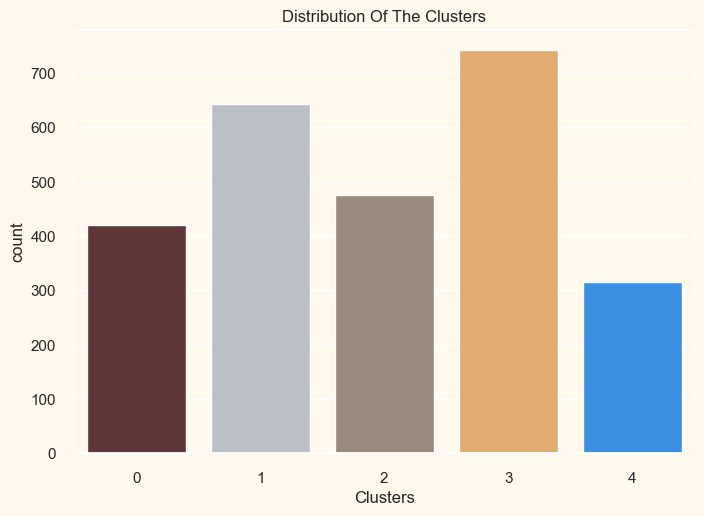

In [158]:
#Plotting countplot of clusters
pal = ["#682F2F","#B9C0C9", "#9F8A78","#F3AB60", "#1E90FF"]
pl = sns.countplot(x=data["Clusters"], palette= pal)
pl.set_title("Distribution Of The Clusters")
plt.show()

The clusters seem to be fairly distributed.

In [160]:
# Calculate the percentage of each cluster
counts = data["Clusters"].value_counts()
percentages = counts / counts.sum() * 100

# Print the percentages
print("Percentage of each cluster:")
print(percentages)

Percentage of each cluster:
3    28.571429
1    24.720832
2    18.328841
0    16.211013
4    12.167886
Name: Clusters, dtype: float64


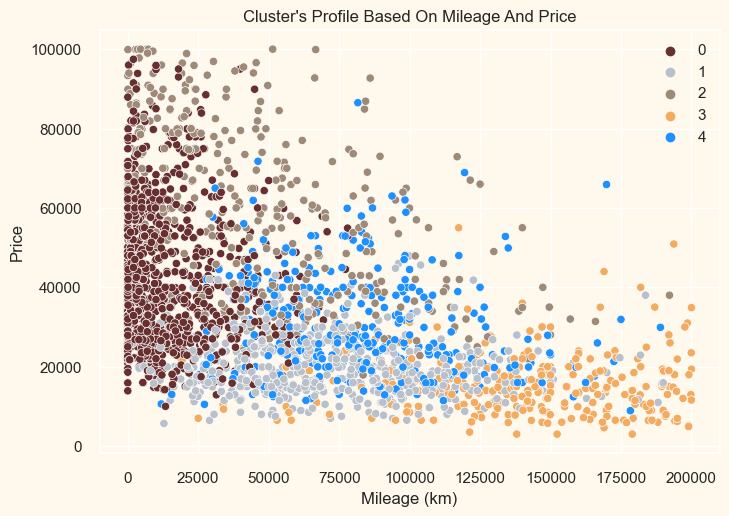

In [45]:
pl = sns.scatterplot(data = data,x=data["Mileage (km)"], y=data["Price"],hue=data["Clusters"], palette= pal)
pl.set_title("Cluster's Profile Based On Mileage And Price")
plt.legend()
plt.show()

**Mileage vs  Price plot shows the clusters pattern**
* group 0: average price &  low milleage
* group 1: low price & average milleage
* group 2: high price & low milleage 
* group 3: low price & high milleage
* group 4: average price & average milleage


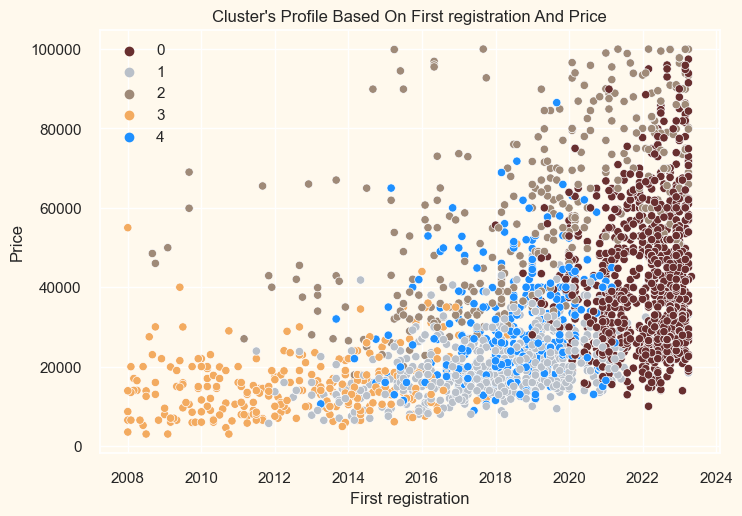

In [46]:
pl = sns.scatterplot(data = data,x=data["First registration"], y=data["Price"],hue=data["Clusters"], palette= pal)
pl.set_title("Cluster's Profile Based On First registration And Price")
plt.legend()
plt.show()

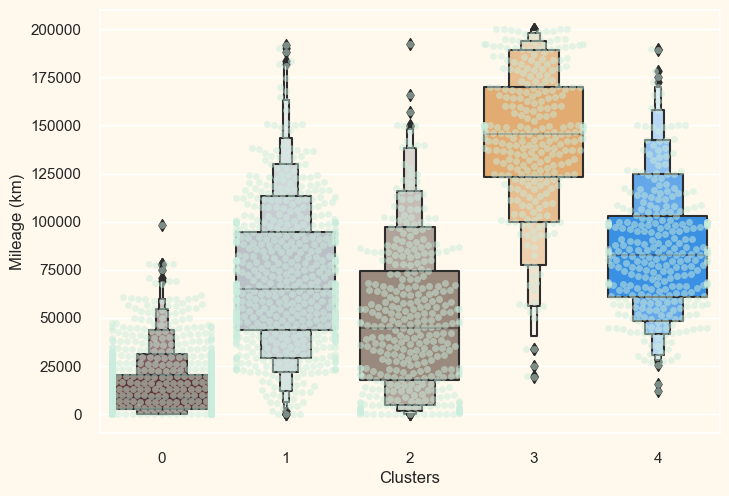

In [47]:
plt.figure()
pl=sns.swarmplot(x=data["Clusters"], y=data["Mileage (km)"], color= "#CBEDDD", alpha=0.5 )
pl=sns.boxenplot(x=data["Clusters"], y=data["Mileage (km)"], palette=pal)
plt.show()

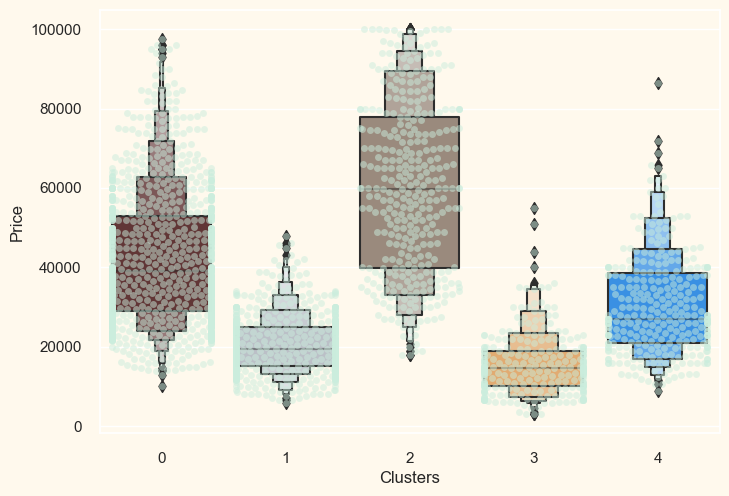

In [48]:
plt.figure()
pl=sns.swarmplot(x=data["Clusters"], y=data["Price"], color= "#CBEDDD", alpha=0.5 )
pl=sns.boxenplot(x=data["Clusters"], y=data["Price"], palette=pal)
plt.show()

From the above plot, it can be seen that cluster 2 is biggest set of automobiles closely followed by cluster 0.

<Figure size 800x550 with 0 Axes>

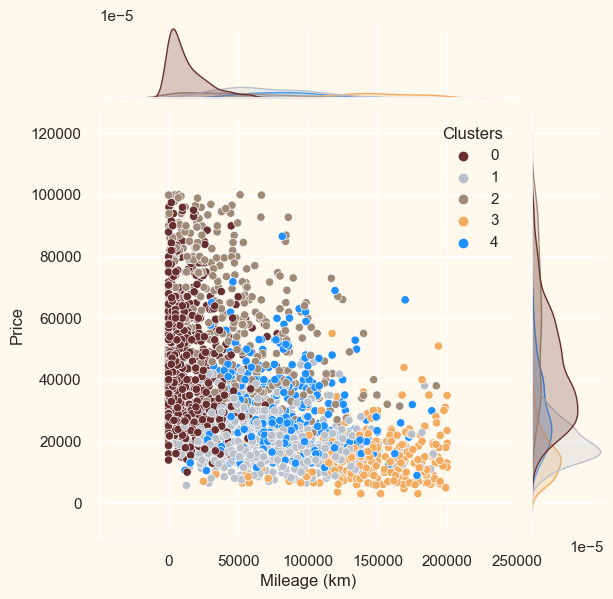

<Figure size 800x550 with 0 Axes>

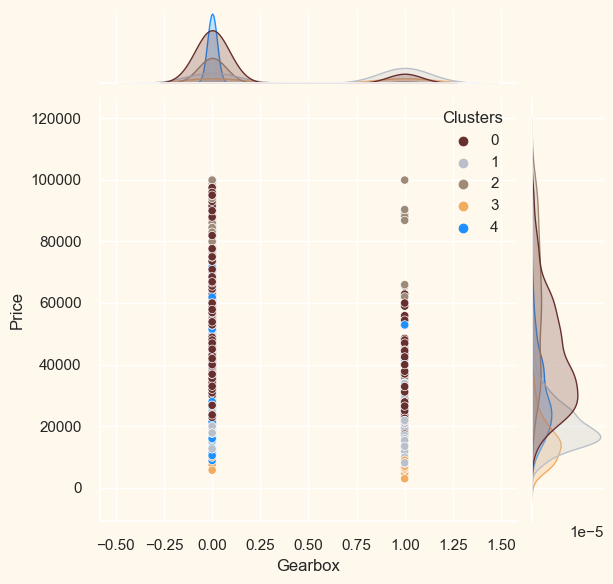

<Figure size 800x550 with 0 Axes>

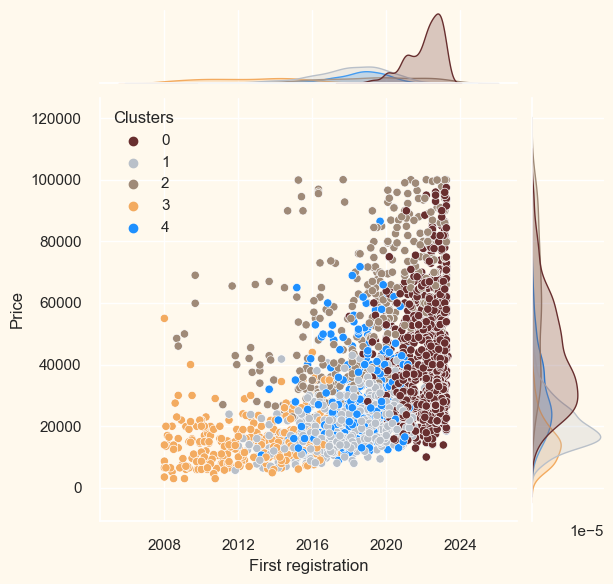

<Figure size 800x550 with 0 Axes>

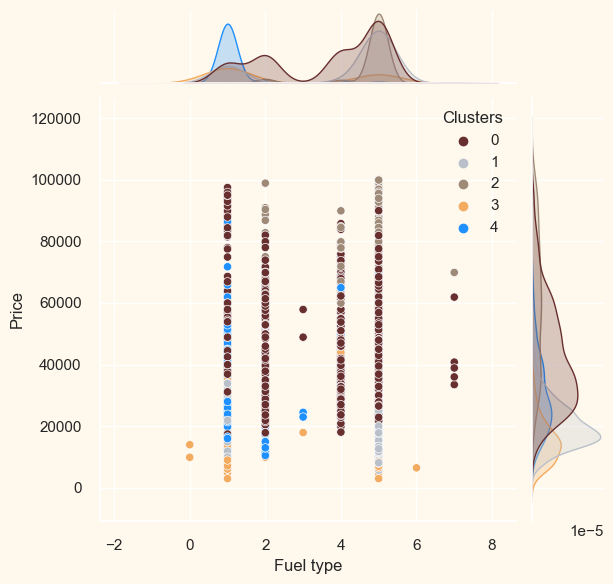

<Figure size 800x550 with 0 Axes>

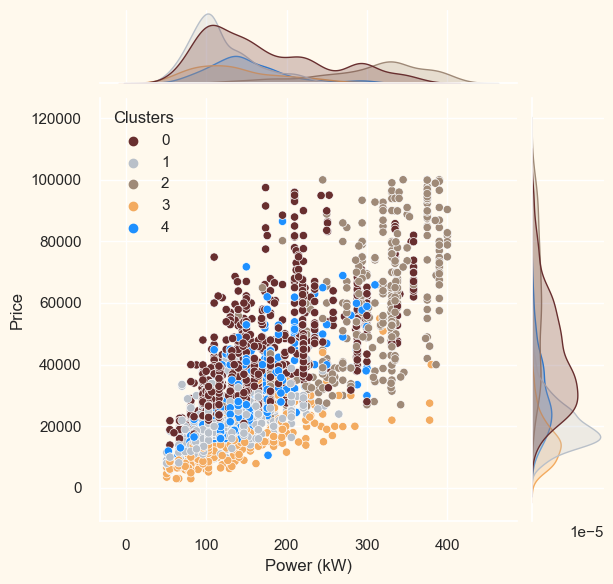

<Figure size 800x550 with 0 Axes>

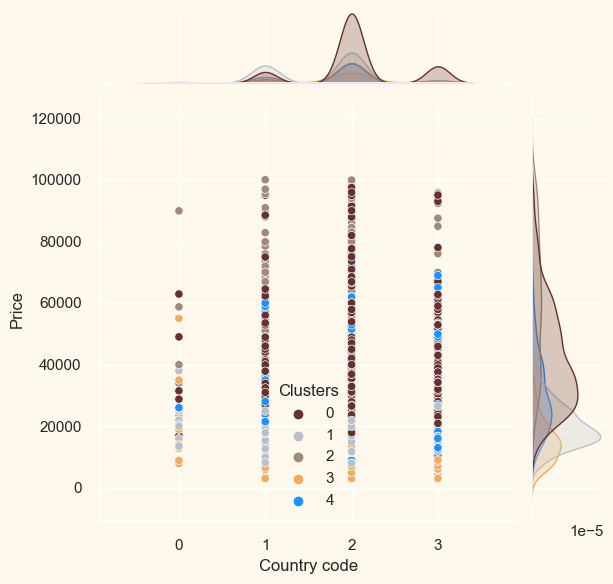

<Figure size 800x550 with 0 Axes>

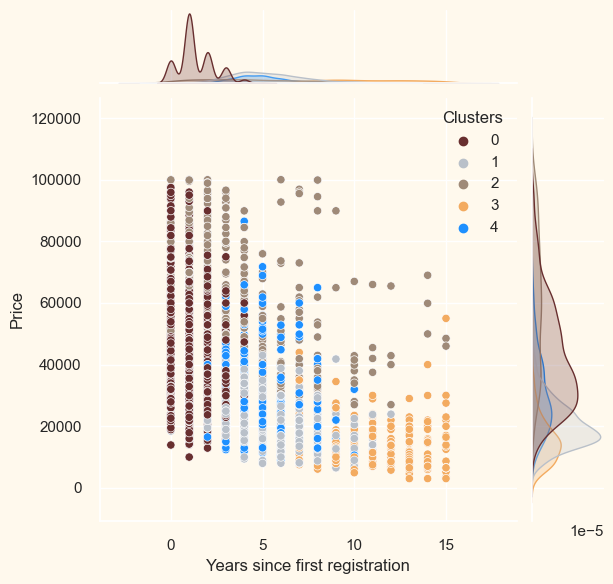

In [52]:
#for more details on the car features 
Features =["Mileage (km)", "Gearbox", "First registration", "Fuel type",  "Power (kW)", "Country code", "Years since first registration"] 

for i in Features:
    plt.figure()
    sns.jointplot(x=data[i],y = data["Price"],hue=data["Clusters"], palette= pal)
    plt.show()

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">PROFILING</p>

Profiling the clusters formed and come to a conclusion about each of them

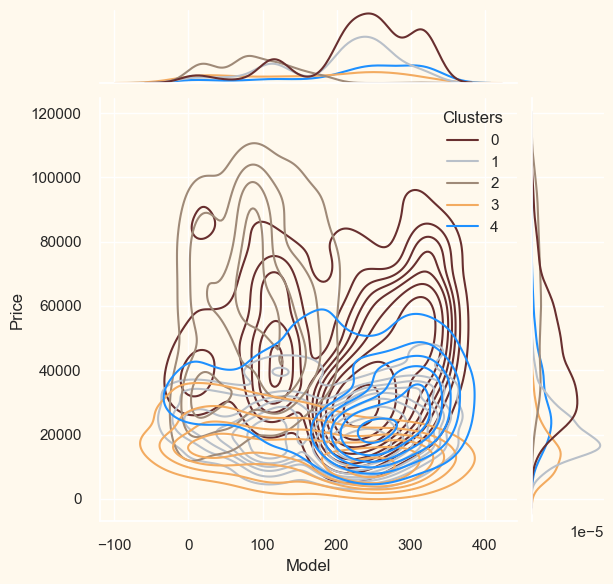

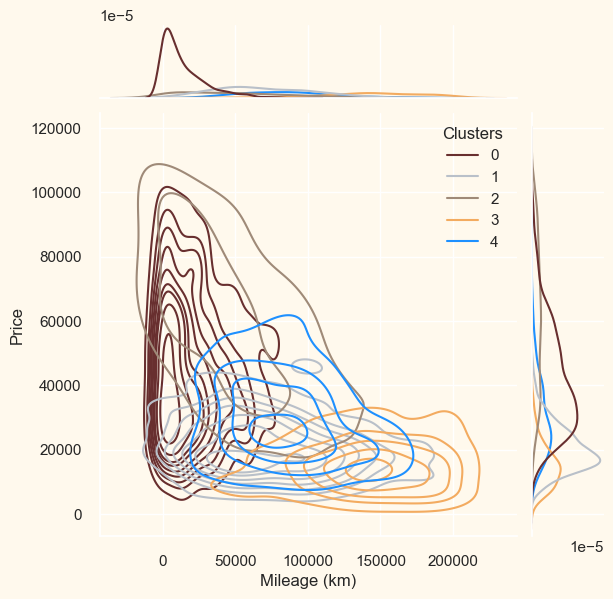

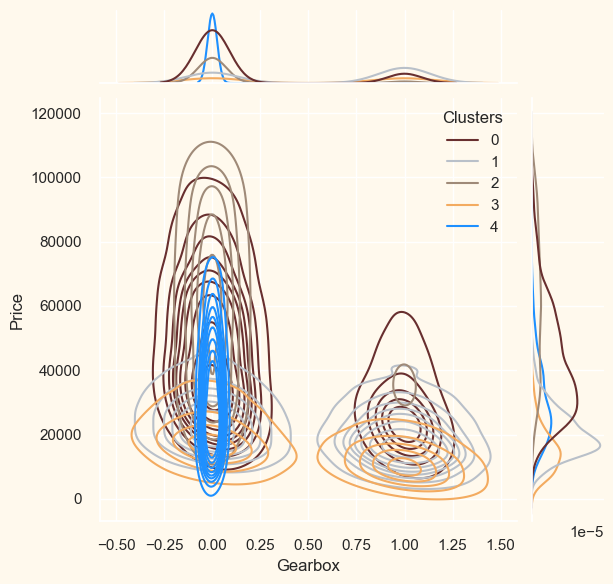

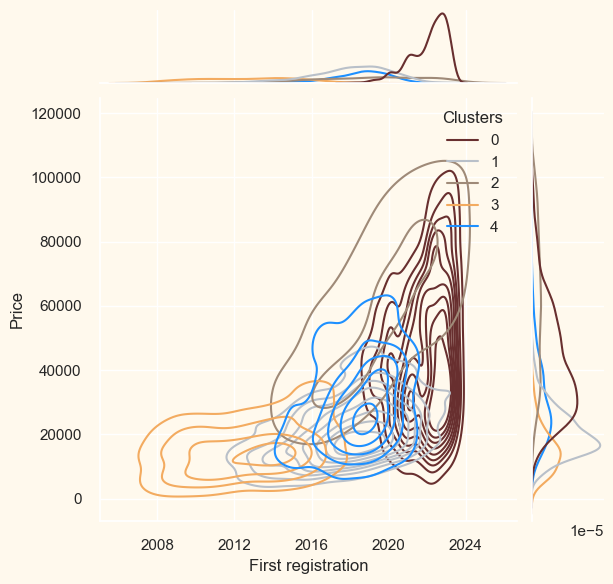

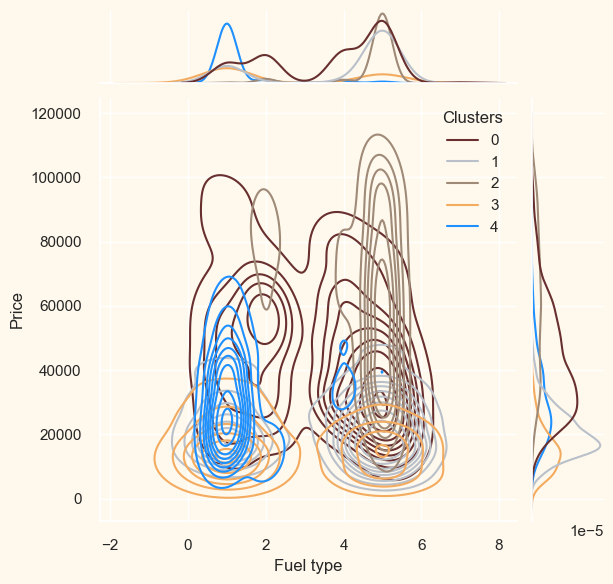

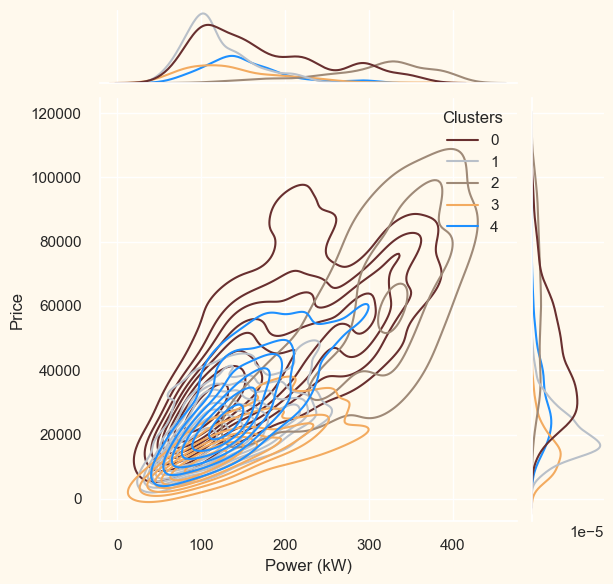

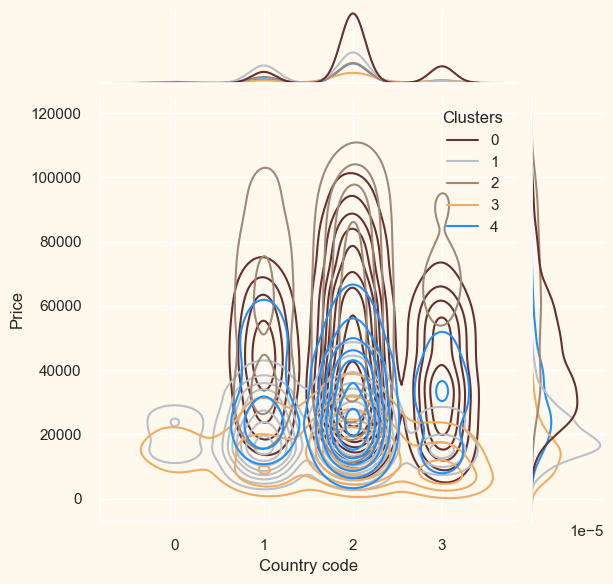

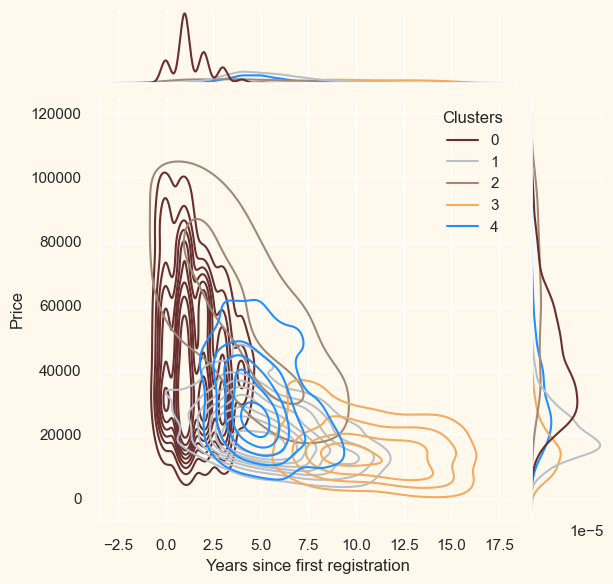

In [152]:
import seaborn as sns

Variables = ["Model", "Mileage (km)", "Gearbox", "First registration", "Fuel type", "Power (kW)", "Country code", "Years since first registration"]

for i in Variables:
    sns.jointplot(x=data[i], y=data["Price"], hue=data["Clusters"], kind="kde", palette=pal)

<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">CONCLUSION</p>

**Points to be noted:**

The following information can be deduced about the different clusters.

## About Cluster Number 0:
- Mileage is definitely low
- Price is evenly distributed
- First registration is new, almost all is in the last couple of years
- Power in this group is mostly low to medium, but in a smaller part it goes towards high

## About Cluster Number 1:
- Mileage is low to average
- Price is low
- First registration is not so new to medium
- Power is low to medium
- Manual transmission is more common in this group

## About Cluster Number 2:
- Mileage is distributed low to medium
- Price starts from medium, but high is more prevalent
- First registration is mostly newer but has a tendency towards middle age
- Power is definitely high

## About Cluster Number 3:
- Mileage is medium to high
- Price is definitely low
- Years since first registration is high
- Power is mostly low

## About Cluster Number 4:
- Price as well as the mileage are scattered around the central part
- Age is mostly medium with a tendency towards younger
- Power is distributed from low to the medium
- Fuel type is quite common diesel

The price of the car in euros and its power in kW are positively correlated in all clusters.


<a id="1"></a>
# <p style="background-color:#00008B;font-family:newtimeroman;color:#FFF9ED;font-size:150%;text-align:center;border-radius:10px 10px;">DATA ANALYTICS TASK</p>

• First I imported the libraries needed for data analytics.

• At the beginning, I imported the data and tried to explore and understand the data to get meaningful insights. 

• In the first part, I analyze quantitative numerical variables without deleting outliers so that I could compare
these early results with latter results from second part where outliers were removed. And to notice the difference 
myself between the results where outliers were not removed and the results where they were removed.

• I used correlation matrix of a dataset to determine how each variable in the dataset is related to every other variable. 
E.g. in my autoscout24 dataset price and power are positively correlated, while price and mileage are negatively correlated.

• With pairplot I visualized the relationships between numerical variables. With histogram, I explored the shape of data 
and the frequency of individual variables. Both showed outliers.

• At the end of the first part boxplots graphically displayed where the outliers are, and I also execute code to calculate outliers mathematically.

• In the second part, I first removed outliers and save the filtered dana for further analysis. Then I performed identical analysis
to visualize and compare how much the data set has changed.  Which rows has been removed as outliers is visible in JN file. 

• After removing extreme values variables now appear more tightly clustered around a central tendency and remaining data points 
are more similar to each other. Histograms shows data more evenly distributed.  Saved df into csv file autoscout24.filtered.csv 
(Number of rows: 2597).

• In the last part, I mostly relied on the example we worked on in the class. Based on what we did, I applied it to my dataset to get a
better insight and apply in practice what we did in class. For this part, I saved the data set as analysis.csv.

• Given that I cleaned the data and removed outliers in the previous steps, I did not deal with it much. For this reason, instead of data
cleaning, I called it data screening, what I did in this step was once again the verification of the data I have.

• For the rest, I followed the instructions from class, doing mostly the same analysis adapted to my data set. 
After converting the categorical variables into numerical ones, I made an short exploration of the converted data.

• Based on the example we did in class, I did almost all the steps, with some things differ in my case and some
steps not be applicable at all, but also there are some additional steps that I done with my data. 
